## Working notebook
Liner shipping shedules and country network construction, analysis (centrailites and community detection) and visualizations

### Table of Contents

* [Process port-to-port dataframe and enrich with metadata information](#1)
* [Undirected countries network construction](#2)
* <a href="">Netowrk properties in 2018</a>
    * [Summary statistics of network distance measures](#3)
    * [Centralities - leading countries in 2018](#4)
    * [Communities detection](#5)
        * [Louvain algorithm](#5.1)
        * [Girvan-Newman](#5.2)
        * [Maximal Cliques](#5.3)
* [Dynamics](#6)
    * [Network measures as time series](#6.1)
    * [Key actors stability for over 14 years](#6.2)

In [8]:
import numpy as np
from scipy import stats
import matplotlib.pyplot as plt
import pandas as pd
import community
import matplotlib.gridspec as gridspec
import matplotlib.colors as mcolors
import matplotlib.patches as mpatches
from collections import Counter
from operator import itemgetter
import json, re, os
import seaborn as sns
from sys import getsizeof
import networkx as nx
import time
import pickle
pd.set_option('display.expand_frame_repr', False)
plt.style.use('ggplot')

In [9]:
## used in later calculations, resolving networkx bug
def connected_component_subgraphs(G):
    for c in nx.connected_components(G):
        yield G.subgraph(c)

## <a class="anchor" id="1">Process port-to-port dataframe and enrich with metadata information</a>

In [11]:
ports = pd.read_csv("ports_data_full.csv")#,index_col=1)
ports.drop(columns=['Unnamed: 0'],inplace=True)
ports.tail()

,Date,Port1,Port2,No of services,Average annual frequency,Average number of ships,Maximum number of ships,Minimum number of ships,No of operators,No of Alliances,...,Max ship size (TEU),StDevP ship size (TEU),Variance ship size (TEU),Average ship age (months),Min ship age (months),Max ship age (months),StDevP ship age (months),Variance ship age (months),Quarterly deployed capacity (TEU),Dates
1598871,2020Q4,CNYTN,BDCGP,1,52.0,4.00,4,4,1,0,...,2700,0.000000,0.000000e+00,20.000000,10,26,6.363961,40.500000,35100.000000,2020-10-01
1598872,2020Q4,JPHTD,VNHPH,4,52.0,3.75,5,3,4,0,...,1740,289.567141,8.384913e+04,161.333333,19,323,92.401780,8538.088889,76001.250000,2020-10-01
1598873,2020Q4,FRLEH,THLCH,1,52.0,17.00,17,17,2,1,...,20568,2966.371132,8.799358e+06,99.666667,41,175,32.951142,1085.777778,193718.777778,2020-10-01
1598874,2020Q4,PTSIE,ZADUR,1,52.0,9.00,9,9,1,0,...,9408,1415.360321,2.003245e+06,137.666667,52,221,62.916170,3958.444444,97554.888889,2020-10-01
1598875,2020Q4,DEHAM,PECLL,2,52.0,8.50,9,8,4,0,...,10926,2932.975402,8.602345e+06,43.153846,30,60,9.130222,83.360947,182262.888889,2020-10-01


#### Metadata get country names from UNSD

In [17]:
meta = pd.read_csv("C:\\Users\\dauly\\math442_final_project\\math442_final_project\\metadata\\UNSD — Methodology.csv",encoding='latin-1')
cdict = dict(zip(list(meta['ISO-alpha2 Code']),list(meta['Country or Area'])))
len(meta)

248

In [18]:
cdict['US'] = "United States"
cdict['CI'] = "Ivory Coast"
cdict['HK'] = "Hong Kong"
cdict['MO'] = "Macao Special Administrative Region"
cdict_inv = {v:k for k,v in cdict.items()}

In [24]:
frame=ports.copy()

frame['Port1_iso'] = frame['Port1'].apply(lambda x: x[:2])
frame['Port2_iso'] = frame['Port2'].apply(lambda x: x[:2])

frame['Dates'] = pd.to_datetime(frame['Dates'])
frame['year'] = frame['Dates'].dt.year

In [22]:
frame.head()

,Date,Port1,Port2,No of services,Average annual frequency,Average number of ships,Maximum number of ships,Minimum number of ships,No of operators,No of Alliances,...,Variance ship size (TEU),Average ship age (months),Min ship age (months),Max ship age (months),StDevP ship age (months),Variance ship age (months),Quarterly deployed capacity (TEU),Dates,Port1_iso,Port2_iso
0,2006Q1,AEAJM,AEAUH,6,35.0,1.0,1,1,1,0,...,0.673469,244.714286,221,266,15.443115,238.489796,4802.0,2006-01-01,AE,AE
1,2006Q1,AEAJM,AEDXB,5,34.8,1.0,1,1,1,0,...,0.925620,235.727273,221,242,8.400118,70.561983,3974.0,2006-01-01,AE,AE
2,2006Q1,AEAJM,AEJEA,6,35.0,1.0,1,1,1,0,...,0.937500,242.958333,221,266,18.045034,325.623264,4802.0,2006-01-01,AE,AE
3,2006Q1,AEAJM,AEKLF,5,31.6,1.0,1,1,1,0,...,0.640000,243.100000,221,266,13.553228,183.690000,3606.0,2006-01-01,AE,AE
4,2006Q1,AEAJM,AEMKH,5,36.0,1.0,1,1,1,0,...,0.987654,239.111111,221,266,16.569345,274.543210,4112.0,2006-01-01,AE,AE


In [25]:
external = frame[frame['Port1_iso']!=frame['Port2_iso']]
frame = external.copy()

internal = frame[frame['Port1_iso']==frame['Port2_iso']]
intr = internal.groupby(['year','Port1_iso'])['Quarterly deployed capacity (TEU)'].sum().reset_index()

##  <a class="anchor" id="2">Undirected countries network construction</a>

Convert to undirected countries network with weighted edges using total deployed capacity on a given shipping route

In [50]:
cntr = frame.groupby(['year','Port1_iso','Port2_iso']).agg({'Quarterly deployed capacity (TEU)':['sum','mean','count']}).reset_index()

cntr.columns = ['year','source','target','weight_sum','weight_mean','weight_count']
cntr['source_id'] = cntr['source'].map(cdict)
cntr['target_id'] = cntr['target'].map(cdict)

In [51]:
data = cntr[cntr['year'] ==2018]
data.describe()

,year,weight_sum,weight_mean,weight_count
count,5364.0,5.364000e+03,5.364000e+03,5364.000000
mean,2018.0,2.143435e+06,9.190388e+04,17.213647
std,0.0,7.950117e+06,1.705505e+05,39.071809
min,2018.0,7.200000e+02,1.800000e+02,1.000000
25%,2018.0,8.358740e+04,1.434760e+04,4.000000
50%,2018.0,3.085836e+05,4.331925e+04,8.000000
75%,2018.0,1.326229e+06,1.137194e+05,16.000000
max,2018.0,1.678076e+08,4.519727e+06,1112.000000


In [31]:
#-Construct the network-#
G = nx.from_pandas_edgelist(data, source="source_id", target="target_id", 
                            edge_attr=['weight_sum', 'weight_mean', 'weight_count'])
print("# of Nodes: {}".format(G.number_of_nodes()))
print("# of Edges: {}".format(G.number_of_edges()))

# of Nodes: 177
# of Edges: 2657


In [32]:
nx.is_connected(G)

True

## <a class="anchor" id="3">Summary statistics of network measures and properties in 2018</a>

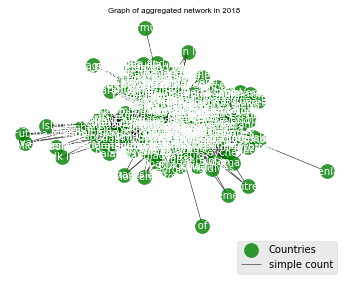

In [34]:
# nodes
options = {"node_size": 200, "alpha": 0.8}
# Position nodes using Fruchterman-Reingold force-directed algorithm
pos = nx.spring_layout(G)
# Drawing the graph
nx.draw_networkx_nodes(G, pos,  node_color="green", **options, label='Countries')
nx.draw_networkx_edges(G, pos, width=0.5,label='simple count')
nx.draw_networkx_labels(G, pos, font_size=10, font_color='white')
plt.title('Graph of aggregated network in 2018', fontsize=8, fontname='Arial')
plt.box(on=None)
plt.axis('off')
plt.legend(bbox_to_anchor=(1, 0), loc='best', ncol=1)
plt.savefig('base.png', dpi=400)

In [35]:
degrees = [val for (node, val) in G.degree()]

print(f"The maximum degree of the Graph is {np.max(degrees)}")   
print(f"The minimum degree of the Graph is {np.min(degrees)}")
print(f"The average degree of the nodes in the Graph is {np.mean(degrees):.1f}")  
print(f"The most frequent degree of the nodes found in the Graph is {stats.mode(degrees)[0][0]}")

The maximum degree of the Graph is 105
The minimum degree of the Graph is 1
The average degree of the nodes in the Graph is 30.0
The most frequent degree of the nodes found in the Graph is 23


Clustering and transitivity measure the tendency for nodes to cluster together or for edges to form triangles. In our context, they are measures of the extent to which the users interacting with one particular user tend to interact with each other as well. The difference is that transitivity weights nodes with a large degree higher.  The clustering coefficient, a measure of the number of triangles in a graph, is calculated as the number of triangles connected to node i divided by the number of sets of two edges connected to node i (Triple nodes). While the transitivity coefficient is calculated as 3 multiply by the number of triangles in the network divided by the number of connected triples of nodes in the network. These two parameters are very important when analyzing social networks because it gives us an insight into how users tend to create tightly knot groups characterized by relatively high-dense ties.


In [36]:
print(f"The average clustering coefficient is {nx.average_clustering(G)} in the largest subgraph")
print(f"The transitivity of the largest subgraph is {nx.transitivity(G)}")

The average clustering coefficient is 0.7186848631042684 in the largest subgraph
The transitivity of the largest subgraph is 0.4955993601879255




After that, we'll investigate some summary statistics, particularly related to distance, or how far away one node is from another random node. Diameter represents the maximum distance between any pair of nodes while the average distance tells us the average distance between any two nodes in the network.


In [37]:
print(f"The diameter of our Graph is {nx.diameter(G)}")
print(f"The average distance between any two nodes is {nx.average_shortest_path_length(G):.2f}")

The diameter of our Graph is 4
The average distance between any two nodes is 2.04


Now, we are going to focus on network centrality which captures the importance of a node's position in the network considering: degree on the assumption that an important node will have many connections, closeness on the assumption that important nodes are close to other nodes, and finally, betweenness on the assumption that important nodes are well situated and connect other nodes. For this, we are going to use the following functions degree_centrality, closenness_centrality and betwenness_centrality, all which return a list of each node and its centrality score. We will particularly capture the node with the best score in each one.

In [39]:
graph_centrality = nx.degree_centrality(G)

max_de = max(graph_centrality.items(), key=itemgetter(1))

graph_closeness = nx.closeness_centrality(G)

max_clo = max(graph_closeness.items(), key=itemgetter(1))

graph_betweenness = nx.betweenness_centrality(G,  endpoints=False)

max_bet = max(graph_betweenness.items(), key=itemgetter(1))

print(f"the node with id {max_de[0]} has a degree centrality of {max_de[1]:.2f} which is the maximum ")
print(f"the node with id {max_clo[0]} has a closeness centrality of {max_clo[1]:.2f} which is the maximum")
print(f"the node with id {max_bet[0]} has a betweenness centrality of {max_bet[1]:.2f} which is the maximum")

the node with id United Kingdom of Great Britain and Northern Ireland has a degree centrality of 0.60 which is the maximum 
the node with id United Kingdom of Great Britain and Northern Ireland has a closeness centrality of 0.70 which is the maximum
the node with id nan has a betweenness centrality of 0.08 which is the maximum


Now, we can get to see how the Graph looks like. For that, we will use nx.drawing.layout to apply node positioning algorithms for the graph drawing. Specifically, we will use spring_layout that uses force-directed graph drawing which purpose is to position the nodes in two-dimensional space so that all the edges are of equal length and as few crossing edges as possible. It achieves this by assigning forces among the set of edges and nodes based on their relative positions and then uses this to simulate the motion of the edges and nodes. One of the parameters that we can adjust is k, the optimal distance between nodes; as we increase the value, the nodes will farther apart. Once, that we got the positions, we are also going to create a special list so that we can draw the two nodes with higher centrality that we found in different colors to highlight them.

In [228]:
node_and_degree = G.degree()
colors_central_nodes = ['orange', 'red','blue']
central_nodes = ['GB', 'US', 'CN']

In [229]:
pos = nx.spring_layout(G, k=0.05)

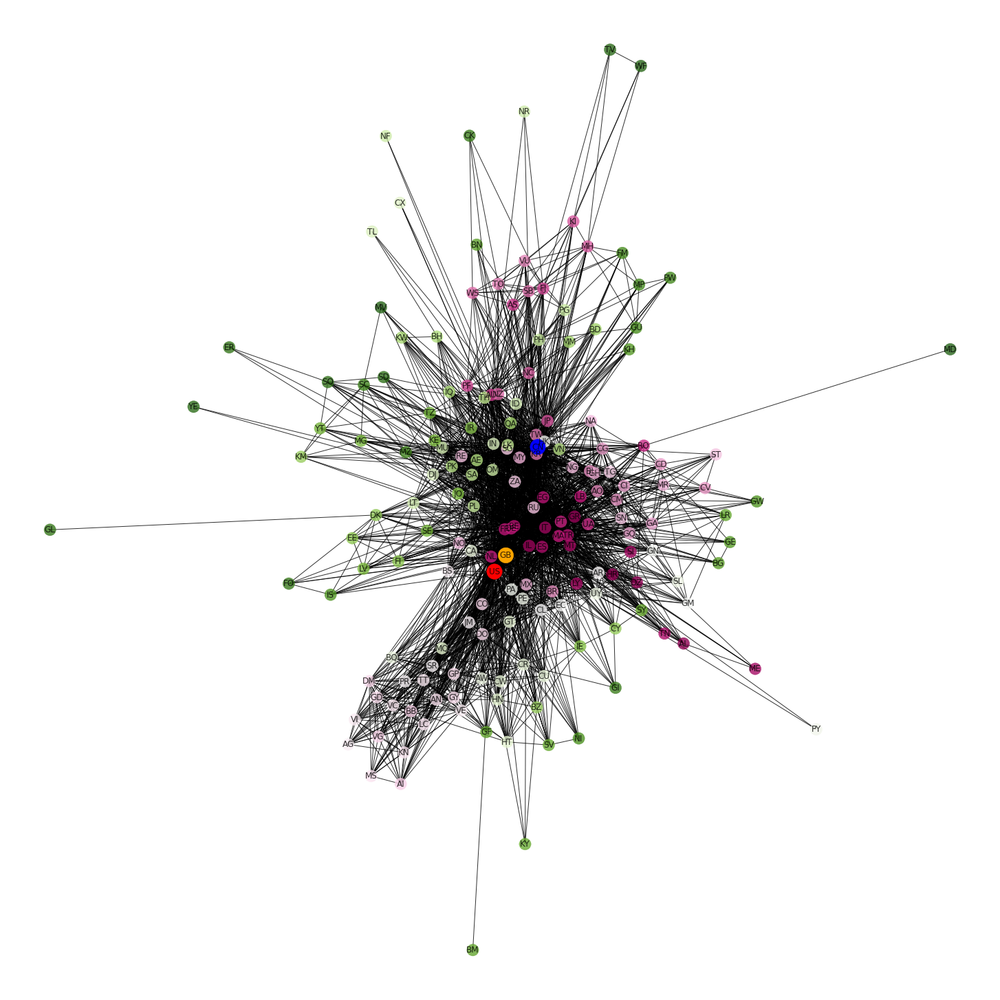

In [232]:
plt.figure(figsize = (10,10))
nx.draw(G, pos=pos, node_color=range(179), cmap=plt.cm.PiYG, edge_color="black", linewidths=0.3
        , node_size=300, alpha=0.8, with_labels=True)
nx.draw_networkx_nodes(G, pos=pos, nodelist=central_nodes, node_size=500, node_color=colors_central_nodes)
plt.savefig('graph_centeral_nodes.png')
plt.show()

In [140]:
#omaking sure names are saved correctly
nx.set_node_attributes(G, values = cdict_inv, name='label')

## <a class="anchor" id="4">Centralities - leading countries in 2018</a>

Unweighted measures

In [446]:
# Centrality Metrics
dict_degree_centrality = nx.degree_centrality(G)
dict_closeness_centrality = nx.closeness_centrality(G)
dict_eigenvector_centrality = nx.eigenvector_centrality(G)
dict_betw_centrality = nx.eigenvector_centrality(G)

In [154]:
# Top 10 nodes with the largest values of degree centrality in descending order
#for k,v in dict(Counter(dict_degree_centrality).most_common(10)).items():
 #   print(meta_dict1.get(k)," - ",meta_dict2.get(k),":",v)
    
    # Top 10 nodes with the largest values of degree centrality in descending order
for k,v in dict(Counter(dict_degree_centrality).most_common(10)).items():
    print(k," - ",cdict_inv.get(k),":",v)

GB  -  United Kingdom : 0.6067415730337078
ES  -  Melilla : 0.5955056179775281
BE  -  Belgium : 0.5955056179775281
US  -  United States : 0.5955056179775281
FR  -  France : 0.5730337078651685
NL  -  Netherlands : 0.5617977528089888
CN  -  China : 0.5561797752808989
IT  -  Italy : 0.5224719101123595
SG  -  Singapore : 0.5112359550561798
DE  -  Germany : 0.5


In [155]:
# Top 10 nodes with the largest values of closeness centrality in descending order
for k, v in dict(Counter(dict_closeness_centrality).most_common(10)).items():
    print(k," - ",cdict_inv.get(k),":",v)

GB  -  United Kingdom : 0.7035573122529645
US  -  United States : 0.7007874015748031
BE  -  Belgium : 0.6980392156862745
ES  -  Melilla : 0.6953125
CN  -  China : 0.6872586872586872
FR  -  France : 0.6846153846153846
NL  -  Netherlands : 0.6819923371647509
SG  -  Singapore : 0.6716981132075471
IT  -  Italy : 0.6617100371747212
KR  -  South Korea : 0.6592592592592592


In [157]:
# Top 10 nodes with the largest values of eigenvector centrality in descending order
for k, v in dict(Counter(dict_eigenvector_centrality).most_common(10)).items():
    print(k," - ",cdict_inv.get(k),":",v)

BE  -  Belgium : 0.18067116074872233
ES  -  Melilla : 0.1802735960849395
GB  -  United Kingdom : 0.1801815364156127
FR  -  France : 0.17684791095590777
NL  -  Netherlands : 0.17274249883885984
CN  -  China : 0.17150281664325323
US  -  United States : 0.17059288743080334
IT  -  Italy : 0.17030131159861955
DE  -  Germany : 0.16569347794809552
SG  -  Singapore : 0.1615322862059682


C:\Users\dauly\Anaconda3\envs\nx\lib\site-packages\ipykernel_launcher.py:5: MatplotlibDeprecationWarning: default base will change from np.e to 10 in 3.4.  To suppress this warning specify the base keyword argument.
  """


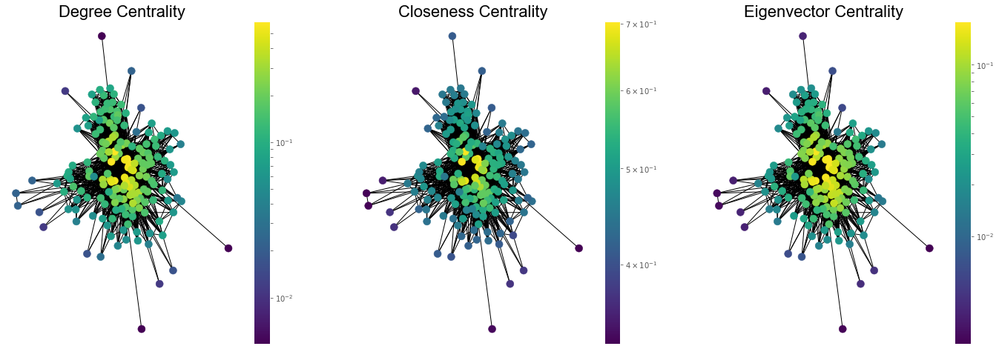

In [63]:
# Function to plot the graphs for each centrality metric
plt.rcParams['figure.figsize']= [24, 8]
def draw(G, pos, lista, listb, measure_name):
    nodes=nx.draw_networkx_nodes(G, pos, node_size=100, cmap=plt.cm.viridis,node_color=lista,nodelist=listb)
    nodes.set_norm(mcolors.SymLogNorm(linthresh=0.01, linscale=1))
    edges=nx.draw_networkx_edges(G, pos)
    plt.title(measure_name, fontsize=22, fontname='Arial')
    plt.colorbar(nodes)
    plt.axis('off')

plt.subplot(1,3,1)
list_pos_values = []
for i in nx.degree_centrality(G).values():
    list_pos_values.append(i)
    list_pos_keys=[]
for i in nx.degree_centrality(G).keys():
    list_pos_keys.append(i)
draw(G, pos, list_pos_values, list_pos_keys, 'Degree Centrality')

plt.subplot(1,3,2)
list_pos_values=[]
for i in nx.closeness_centrality(G).values():
    list_pos_values.append(i)
    list_pos_keys=[]
for i in nx.closeness_centrality(G).keys():
    list_pos_keys.append(i)
draw(G, pos, list_pos_values, list_pos_keys, 'Closeness Centrality')

plt.subplot(1,3,3)
list_pos_values=[]
for i in nx.eigenvector_centrality(G).values():
    list_pos_values.append(i)
    list_pos_keys=[]
for i in nx.eigenvector_centrality(G).keys():
    list_pos_keys.append(i)
draw(G, pos, list_pos_values, list_pos_keys, 'Eigenvector Centrality')
plt.savefig('centrality_summary.png' , dpi=400)

##  <a class="anchor" id="5">Communities detection</a>

Library community previously installed using pip install

Documentation for the library is avaiable here: 
https://python-louvain.readthedocs.io/en/latest/

### <a class="anchor" id="5.1"> Louvain algorithm for Community Detection</a>

In [56]:
# Starting with an initial partition of the graph and running the Louvain algorithm for Community Detection
partition=community.best_partition(G, weight='weight')
print('Completed Louvain algorithm .. . . ' )
values=[partition.get(node) for node in G.nodes()]
list_com=partition.values()

Completed Louvain algorithm .. . . 


In [57]:
# Creating a dictionary like {community_number:list_of_participants}
dict_nodes={}

In [58]:
# Starting with an initial partition of the graph and running the Louvain algorithm for Community Detection
partition=community.best_partition(G, weight='weight')
print('Completed Louvain algorithm .. . . ' )
values=[partition.get(node) for node in G.nodes()]
list_com=partition.values()

# Creating a dictionary like {community_number:list_of_participants}
dict_nodes={}

# Populating the dictionary with items
for each_item in partition.items():
    community_num=each_item[1]
    community_node=each_item[0]
    if community_num in dict_nodes:
        value=dict_nodes.get(community_num) + ' | ' + str(community_node)
        dict_nodes.update({community_num:value})
    else:
        dict_nodes.update({community_num:community_node})

# Creating a dataframe from the diet, and getting the output into excel
community_df=pd.DataFrame.from_dict(dict_nodes, orient='index',columns=['Members'])
community_df.index.rename('Community_Num' , inplace=True)
community_df.to_csv('Community_List_snippet.csv')



Completed Louvain algorithm .. . . 


In [59]:
community_df.head()

,Members
Community_Num,
0,United Arab Emirates | Bahrain | Djibouti | Eg...
1,Belgium | Benin | Congo | Germany | Spain | Fr...
2,Bahamas | Canada | United Kingdom of Great Bri...
3,China | Hong Kong | Japan | Republic of Korea ...


In [60]:
# Creating a new graph to represent the communities created by the Louvain algorithm
plt.rcParams['figure.figsize']= [12, 8]
G_comm=nx.Graph()

# Populating the data from the node dictionary created earlier
G_comm.add_nodes_from(dict_nodes)

# Calculating modularity and the total number of communities
mod=community.modularity(partition,G)
print("Modularity: ", mod)
print("Total number of Communities=", len(G_comm.nodes()))

# Creating the Graph and also calculating Modularity
# matplotlib.rcParams['figure.figsize']= [12, 8]
# pos_louvain=nx.spring_layout(G_comm)
# nx.draw_networkx(G_comm, pos_louvain, with_labels=True,node_size=160,font_size=11,label='Modularity =' + str(round(mod,3)) +
#                     ', Communities=' + str(len(G_comm.nodes())))
# plt.suptitle('Community structure (Louvain Algorithm)',fontsize=22,fontname='Arial')
# plt.box(on=None)
# plt.axis('off')
# plt.legend(bbox_to_anchor=(0,1), loc='best', ncol=1)
#plt.savefig('louvain.png',dpi=400, bbox_inches='tight')

Modularity:  0.3240641284007179
Total number of Communities= 4


In [164]:
community_df

,Members
Community_Num,
0,AL | DZ | HR | GR | IL | IT | LY | MT | ME | S...
1,ES | BE | FR | MA | PT | AO | BJ | CM | CV | C...
2,NL | GB | US | BR | MX | AI | BB | VG | CO | D...
3,AS | AU | CN | FJ | PF | JP | KI | MH | NC | N...
4,MY | RE | SG | ZA | DJ | IN | LT | MU | OM | P...


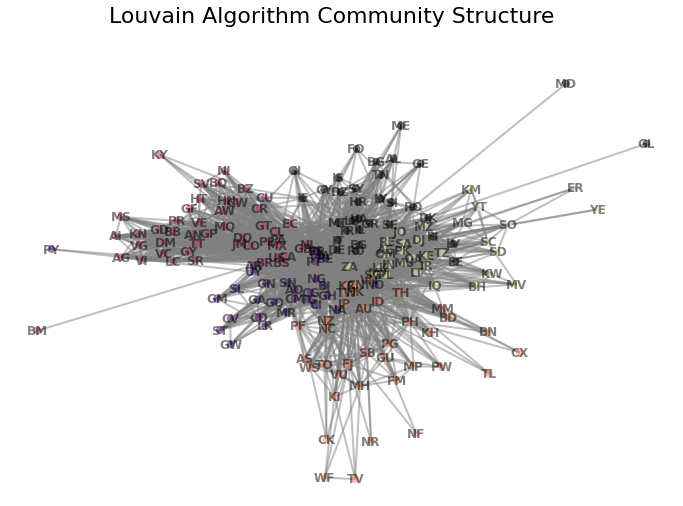

In [176]:
# Now we try to obtain the color coded graph for each community
options = { "alpha": 0.5,"edge_color":"grey", "width":2, 'font_color':'black','font_weight':'bold' }
nx.draw_networkx(G, pos, cmap=plt.get_cmap('magma'), node_color=values,node_size=50, with_labels=True,**options)
plt.suptitle('Louvain Algorithm Community Structure',fontsize=22)
plt.box(on=None)
plt.axis('off')
plt.savefig('louvain_2.png',dpi=400, bbox_inches='tight')
plt.show()

###  <a class="anchor" id="5.2"> Girvan-Newman Algorithm</a>

In [177]:
# Using the Girvan-Newman algorithm to create a Communicty Structure
from networkx.algorithms.community.centrality import girvan_newman
comp=girvan_newman(G)

In [178]:
# Creating a dictionary for the community number assocaited with each node
com=0
thisdict={}

# Populating the items of the dictionary
for c in next(comp):
    listed=sorted(c)
    for i in range(len(listed)):
        if listed[i] in thisdict:
            print('already found')
        else:
            thisdict.update({listed[i]: com})
        i+=1
    com+=1

values_girvan=[thisdict.get(node) for node in G.nodes()]
values_girvan

[0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0]

Total number of Communities= 2
Modularity: -6.441808060257168e-08


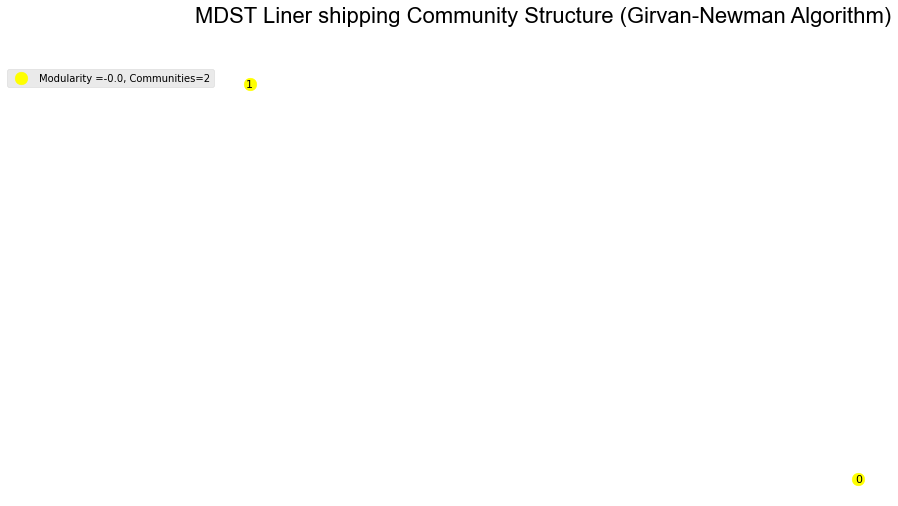

In [179]:
# Creating a dictionary like 'Community num':'List of participants'
dict_nodes_girvan={}
for each_item in thisdict.items():
    community_num=each_item[1]
    community_node=each_item[0]
    
    if community_num in dict_nodes_girvan:
        value=dict_nodes_girvan.get(community_num) + ' | ' + str(community_node)
        dict_nodes_girvan.update({community_num: value})
    else:
        dict_nodes_girvan.update({community_num: community_node})
        
# Creating the output file
community_df_girvan=pd.DataFrame.from_dict(dict_nodes_girvan, orient='index',columns=['Members'])
community_df_girvan.index.rename('Community Num', inplace=True)
community_df_girvan.to_csv('Community_List_girvan_snippet.csv')

# Creating a graph where each node represents a community
G_comm_girvan=nx.Graph()
G_comm_girvan.add_nodes_from(dict_nodes_girvan)

# Calculation of number of communities and modularity
print("Total number of Communities=", len(G_comm_girvan.nodes()))
mod_girv=community.modularity(thisdict,G)
print("Modularity:", mod_girv)

# Creation of the graph
# pos_girvan=nx.spring_layout(G_comm_girvan)
# nx.draw_networkx(G_comm_girvan, pos_girvan,with_labels=True,node_size=160,font_size=11, node_color='yellow',
#                  label='Modularity =' + str(round(mod_girv,3)) +', Communities=' + str(len(G_comm_girvan.nodes())))
# plt.suptitle('MDST Liner shipping Community Structure (Girvan-Newman Algorithm)',fontsize=22,fontname='Arial')
# plt.box(on=None)
# plt.axis('off')
# plt.legend(bbox_to_anchor=(0,1), loc='best', ncol=1)
# plt.savefig('Girvan-Newman.png', dpi=400, bbox_inches='tight')

In [180]:
# Viewing the list of communities
community_df_girvan

,Members
Community Num,
0,AE | AG | AI | AL | AN | AO | AR | AS | AU | A...
1,BM


### <a class="anchor" id="5.3">Maximal Cliques</a>

In [181]:
#Finding the Maximal Cliques associated with teh graph
a=nx.find_cliques(G)
i=0

# For each clique, print the members and also print the total number of communities
for clique in a:
    print (clique)
    i+=1
total_comm_max_cl=i
print('Total number of communities: ',total_comm_max_cl)

['MS', 'VC', 'BB', 'AI', 'VE', 'CO', 'AN', 'DM', 'DO', 'TT', 'KN', 'GD', 'US', 'GP', 'VG']
['AL', 'IT', 'GR', 'TR', 'SI', 'HR', 'IL']
['AL', 'IT', 'GR', 'TR', 'SI', 'HR', 'MT']
['AL', 'IT', 'GR', 'TR', 'SI', 'LY', 'MT']
['AL', 'IT', 'GR', 'TR', 'ES', 'IL', 'HR']
['AL', 'IT', 'GR', 'TR', 'ES', 'MT', 'HR']
['AL', 'IT', 'GR', 'TR', 'ES', 'MT', 'TN', 'DZ', 'LY']
['AL', 'IT', 'ME', 'SI', 'HR', 'MT']
['IQ', 'OM', 'SA', 'IN', 'AE', 'SG', 'PK', 'KW', 'QA', 'KR', 'IR']
['IQ', 'OM', 'SA', 'IN', 'AE', 'SG', 'PK', 'KW', 'QA', 'BH']
['IQ', 'OM', 'SA', 'IN', 'AE', 'SG', 'PK', 'MY', 'HK', 'CN', 'LK', 'KR', 'ES', 'IT', 'IR', 'DE', 'BE']
['IQ', 'OM', 'SA', 'IN', 'AE', 'SG', 'PK', 'MY', 'HK', 'CN', 'LK', 'KR', 'ES', 'IT', 'IR', 'QA']
['IQ', 'OM', 'SA', 'IN', 'AE', 'SG', 'PK', 'MY', 'HK', 'CN', 'BH', 'QA']
['IQ', 'OM', 'SA', 'IN', 'AE', 'SG', 'TW', 'LK', 'MY', 'HK', 'CN', 'KR', 'ES', 'IT', 'IR', 'DE', 'BE']
['IQ', 'OM', 'SA', 'IN', 'AE', 'SG', 'TW', 'LK', 'MY', 'HK', 'CN', 'KR', 'ES', 'IT', 'IR', 'QA']
[

In [182]:
from math import *
import itertools as it

# Defining a circle that can be drawn around each community
def draw_circle_around_clique(clique,coords):
    dist=0
    temp_dist=0
    center=[0 for i in range(2)]
    color=next(colors)
    for a in clique:
        for b in clique:
            temp_dist=(coords[a][0]-coords[b][0])**2+(coords[a][1]-coords[b][1])**2
            if temp_dist>dist:
                dist=temp_dist
                for i in range(2):
                    center[i]=(coords[a][i]+coords[b][i])/2
    rad=dist**0.5/2
    cir=plt.Circle((center[0],center[1]),radius=rad*1.3,fill=False,color=color)
    plt.gca().add_patch(cir)
    plt.axis('scaled')
    return color

# Setting a cycle of colors,
global colors, hatches
colors=it.cycle('b')

Clique to appear :  ['MS', 'VC', 'BB', 'AI', 'VE', 'CO', 'AN', 'DM', 'DO', 'TT', 'KN', 'GD', 'US', 'GP', 'VG']
Clique to appear :  ['AL', 'IT', 'GR', 'TR', 'SI', 'HR', 'IL']
Clique to appear :  ['AL', 'IT', 'GR', 'TR', 'SI', 'HR', 'MT']
Clique to appear :  ['AL', 'IT', 'GR', 'TR', 'SI', 'LY', 'MT']
Clique to appear :  ['AL', 'IT', 'GR', 'TR', 'ES', 'IL', 'HR']
Clique to appear :  ['AL', 'IT', 'GR', 'TR', 'ES', 'MT', 'HR']
Clique to appear :  ['AL', 'IT', 'GR', 'TR', 'ES', 'MT', 'TN', 'DZ', 'LY']
Clique to appear :  ['AL', 'IT', 'ME', 'SI', 'HR', 'MT']
Clique to appear :  ['IQ', 'OM', 'SA', 'IN', 'AE', 'SG', 'PK', 'KW', 'QA', 'KR', 'IR']
Clique to appear :  ['IQ', 'OM', 'SA', 'IN', 'AE', 'SG', 'PK', 'KW', 'QA', 'BH']
Clique to appear :  ['IQ', 'OM', 'SA', 'IN', 'AE', 'SG', 'PK', 'MY', 'HK', 'CN', 'LK', 'KR', 'ES', 'IT', 'IR', 'DE', 'BE']
Clique to appear :  ['IQ', 'OM', 'SA', 'IN', 'AE', 'SG', 'PK', 'MY', 'HK', 'CN', 'LK', 'KR', 'ES', 'IT', 'IR', 'QA']
Clique to appear :  ['IQ', 'OM', '

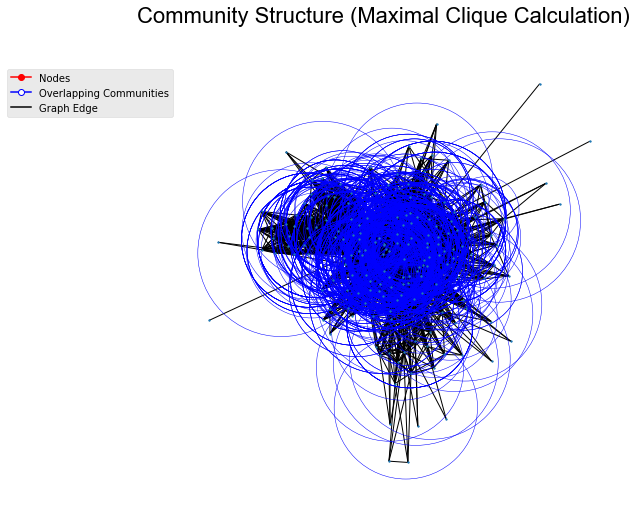

In [184]:
# Remove "len(clique)>2" - interested in maxcliques with 2 edges
cliques=[clique for clique in nx.find_cliques(G) if len(clique)>2]

# Draw the graph
nx.draw_networkx(G,pos, node_size=3, with_labels=False)
for clique in cliques:
    print("Clique to appear : ",clique)
    nx.draw_networkx_nodes(G,pos,nodelist=clique,node_color=draw_circle_around_clique(clique,pos),node_size=1000, alpha=0)
plt.suptitle('Community Structure (Maximal Clique Calculation)',fontsize=22, fontname='Arial')
plt.box(on=None)
plt.axis('off')
         
red_patch=mpatches.Patch(color='r', label='Nodes')
#blue_patch = plt.Circle(color='b', label='Overlapping Communities', fill=False)

red_patch=plt.Line2D([],[], color="red", marker='o', markerfacecolor="red",label='Nodes')
blue_patch=plt.Line2D([],[], color="blue", marker='o', markerfacecolor='white',label='Overlapping Communities')
black_patch=plt.Line2D([],[], color="black",label='Graph Edge')
plt.legend(handles=[red_patch,blue_patch, black_patch],bbox_to_anchor=(0,1), loc='best', ncol=1)
plt.savefig('Cliques.png',dpi=400, bbox_inches='tight')
plt.show()

----------

## <a class="anchor" id="6"> Dynamics </a>

* deriving network distance and centralities measures for each yeat of data avaiable 
* for each year avaiable, saving the results

In [287]:
year_list = list(intr['year'].unique())

In [323]:
def degree_cal(G):
    degree_dict = dict(G.degree(G.nodes()))
    nx.set_node_attributes(G, degree_dict, 'degree')
    sorted_degree = sorted(degree_dict.items(), key=itemgetter(1), reverse=True)
    print("Top 20 nodes by degree:")
    for d in sorted_degree[:20]:
        print(d)
    mean_degree = sum([x[1] for x in sorted_degree])/len(sorted_degree)
        
    return G, mean_degree

def ecc_cal(G):
    ecc_dict = nx.eccentricity(G)
    nx.set_node_attributes(G, ecc_dict, 'eccentricity')
    sorted_degree = sorted(ecc_dict.items(), key=itemgetter(1), reverse=True)
    print("Top 20 nodes by eccentricity:")
    for d in sorted_degree[:20]:
        print(d)
    mean_ecc = sum([x[1] for x in sorted_degree])/len(sorted_degree)
        
    return G, mean_ecc

In [ ]:
#list_ext = []
gdict = {}
frames_list = []
dhist_dict = {}
for y in year_list:
    new  = external[external['year']==y]
    
    cntr = new.groupby(['Port1_iso','Port2_iso']).agg({'Quarterly deployed capacity (TEU)':'sum'}).reset_index()
    cntr.columns = ['source','target','weight_sum']
    cntr['source_name'] = cntr['source'].map(cdict)
    cntr['target_name'] = cntr['target'].map(cdict)
    G = nx.from_pandas_edgelist(cntr, source="source", target="target", 
                            edge_attr='weight_sum')
   
    nx.set_node_attributes(G, values = cdict_inv, name='label')
    #adj = nx.convert_matrix.to_pandas_adjacency(G, weight="weight_sum", nonedge=np.NaN)
    G,mean_degree = degree_cal(G)
    G, ecc_mean = ecc_cal(G)
    mydict = {y: {"No_edges":G.size(),
                  "No_nodes": G.order(),
                  "Avg_degree": mean_degree,
                  "Global_Clustering": nx.average_clustering(G),
                  "Transitivity": nx.transitivity(G),
                  "Avg degree connectivity": nx.average_degree_connectivity(G),
                  "Avg_path_length": nx.average_shortest_path_length(G),
                  "Radius": nx.radius(G),
                  "Diameter": nx.diameter(G),
                  "eccentricity": ecc_mean, #The center is the set of nodes with eccentricity equal to radius.
                  "center": " ".join([x for x in sorted(nx.center(G),reverse=True)]),
                  "periphery": " ".join([x for x in sorted(nx.periphery(G),reverse=True)]),# periphery is the set of nodes with eccentricity equal to the diameter.
                  "density":nx.density(G),
                  "Assortativity":nx.degree_assortativity_coefficient(G),
                  "Global efficiency": nx.global_efficiency(G)}} ##  weights ignored
    dhist_dict.update({y:nx.degree_histogram(G)})
    gdict.update(mydict)
    degrees = nx.degree_centrality(G)
    closeness = nx.closeness_centrality(G, distance='weight_sum')
    betweeness = nx.betweenness_centrality(G, weight='weight_sum')
    eigs = nx.eigenvector_centrality(G, weight='weight_sum')
    
    dfn = pd.DataFrame([degrees, closeness, betweeness, eigs]).transpose()
    dfn.columns = ['degrees', 'closeness', 'betweeness', 'eigs']
    print(dfn.head())
    dfn['year'] = y
    dfn.reset_index(inplace=True, drop=False)
    df2 = pd.melt(dfn,id_vars = ['index','year'],value_name= 'value',var_name = "centrality")
    print(df2.tail())
    frames_list.append(df2)
    nx.write_gpickle(G,os.path.join("C:\\Users\\dauly\\Desktop\\mdst\\pickled","net_cntr_{}.gpickle".format(y)))


In [453]:
output = pd.DataFrame.from_dict(mydict, orient='index')
output.to_csv("output_network_country.csv")

Top 20 nodes by degree:
('GB', 121)
('BE', 116)
('ES', 112)
('US', 110)
('FR', 104)
('DE', 101)
('NL', 97)
('IT', 96)
('HK', 91)
('SG', 85)
('CN', 84)
('MY', 78)
('KR', 75)
('TW', 73)
('JP', 71)
('EG', 61)
('BR', 60)
('IN', 60)
('SA', 60)
('CA', 59)
Top 20 nodes by eccentricity:
('SO', 4)
('HT', 4)
('KN', 4)
('VG', 4)
('VI', 4)
('AI', 4)
('WF', 4)
('NF', 4)
('BM', 4)
('BZ', 4)
('CK', 4)
('GL', 4)
('TC', 4)
('KY', 4)
('KM', 4)
('KP', 4)
('AE', 3)
('AO', 3)
('AR', 3)
('BH', 3)
     degrees  closeness  betweeness      eigs
AE  0.320000   0.000028    0.001270  0.073783
AO  0.211429   0.000021    0.000394  0.001537
AR  0.240000   0.000027    0.002463  0.021568
BE  0.662857   0.000041    0.189134  0.103143
BH  0.080000   0.000028    0.008374  0.000932
    index  year centrality     value
699    KY  2006       eigs  0.000116
700    SC  2006       eigs  0.000238
701    ME  2006       eigs  0.000022
702    KM  2006       eigs  0.000006
703    KP  2006       eigs  0.000005
Top 20 nodes by degree

In [454]:
pd.DataFrame.from_dict(gdict).T.to_csv("network_level_stats.csv")

In [455]:
centals = pd.concat(frames_list)
centals['country'] = centals['index'].map(cdict)
centals.to_csv("Centralities.csv")

###  <a class="anchor" id="6.1">Network measures as time series</a>
   

In [346]:
sns.set_style("ticks")

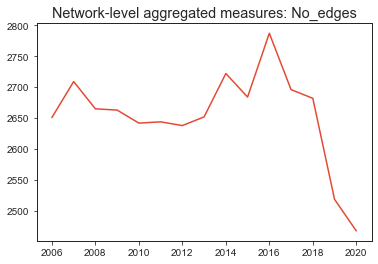

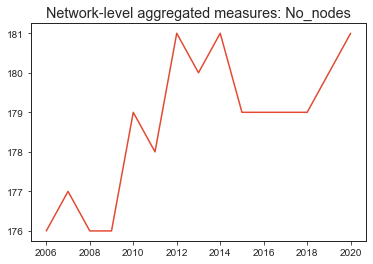

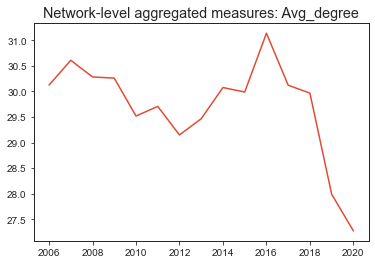

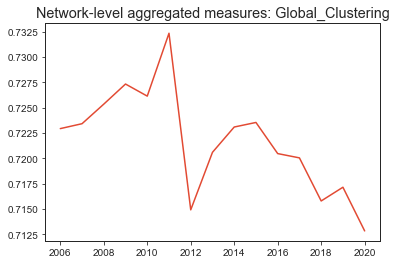

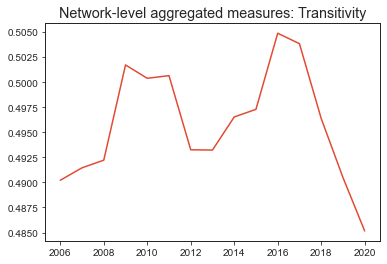

...

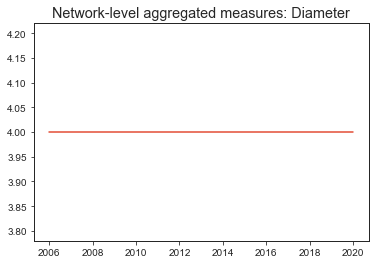

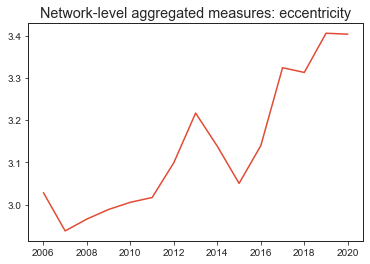

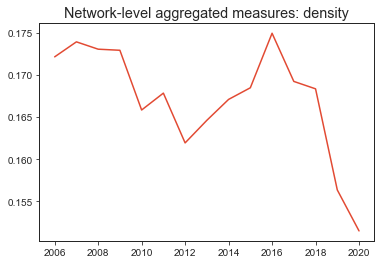

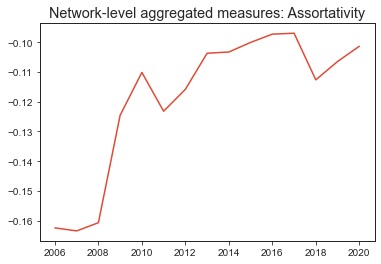

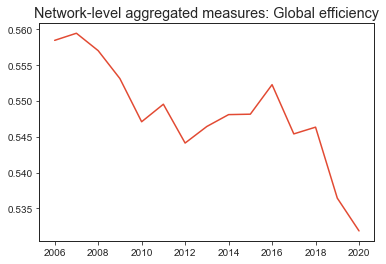

In [458]:
output = pd.DataFrame.from_dict(gdict, orient='index')
for o in list(output.columns):
    if o !='center' and o!='periphery':
        try:
            fig, ax = plt.subplots()
            output[o].plot(ax=ax)
            plt.title("Network-level aggregated measures: {}".format(o))
            plt.show()
            fig.savefig("net_measure_ts_{}".format(o))
        except TypeError:
            pass
output.to_csv("output_network_country.csv")
    

###  <a class="anchor" id="6.2">Key actors stability for over 14 years of data</a>

2006 ['BE', 'SB', 'AS', 'MV', 'CA']
2007 ['GB', 'MV', 'GY', 'AS', 'BE']
2008 ['YE', 'MV', 'GB', 'GR', 'UA']
2009 ['AR', 'ZA', 'QA', 'BE', 'KW']
2010 ['BE', 'KW', 'ZA', 'AU', 'UA']
2011 ['AU', 'UA', 'BE', 'GH', 'ZA']
2012 ['BE', 'GI', 'AU', 'SR', 'SG']
2013 ['BE', 'NO', 'LY', 'YT', 'FR']
2014 ['BE', 'FR', 'NO', 'YT', 'CA']
2015 ['BE', 'GB', 'FR', 'YT', 'KW']
2016 ['BE', 'FR', 'FI', 'LY', 'GB']
2017 ['BE', 'QA', 'MX', 'PL', 'SI']
2018 ['BE', 'GB', 'IQ', 'SG', 'SY']
2019 ['BE', 'MX', 'GY', 'FR', 'SY']
2020 ['BE', 'MX', 'ID', 'GY', 'SY']


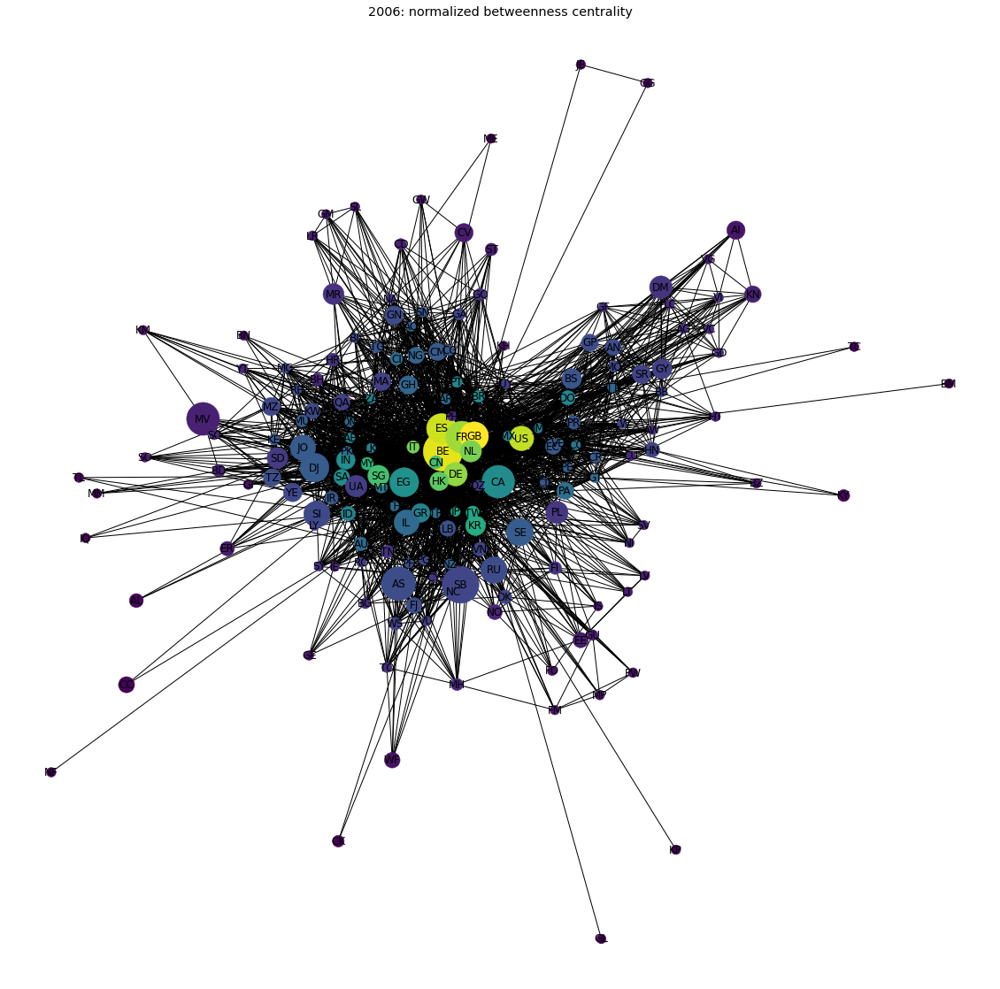

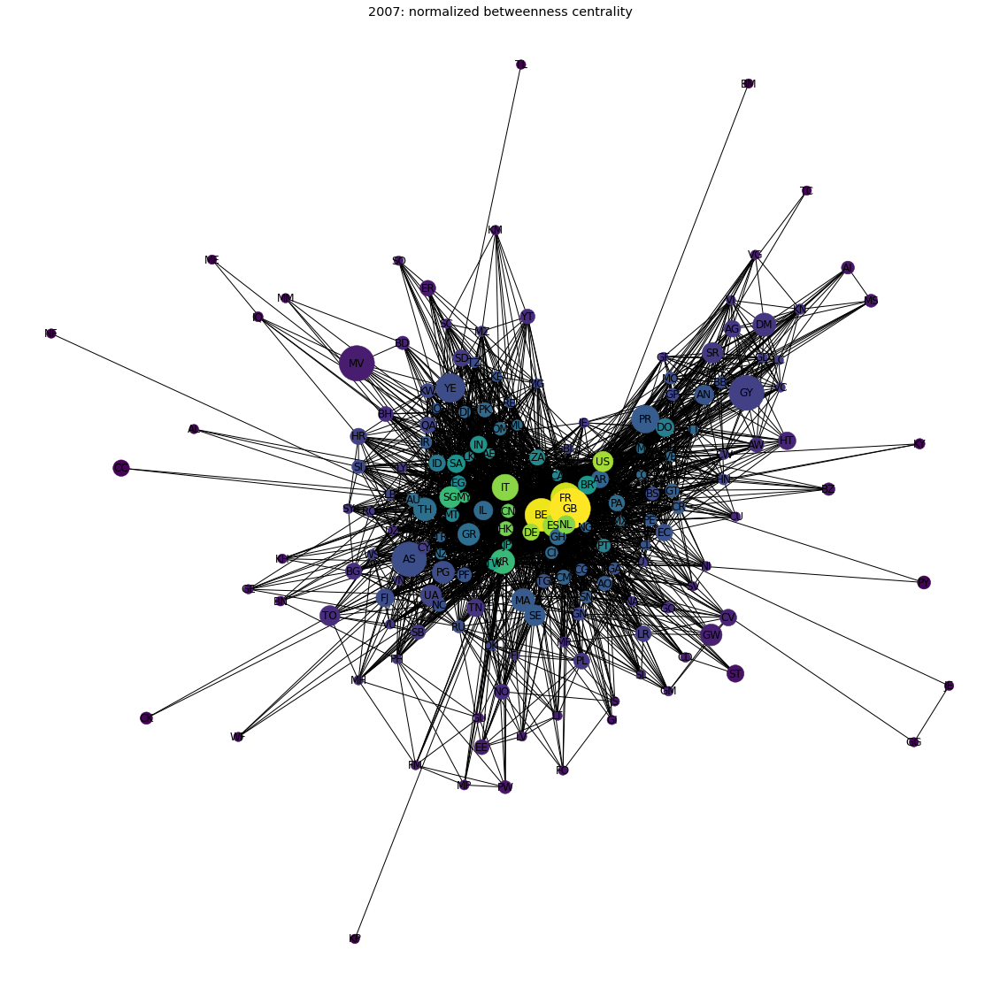

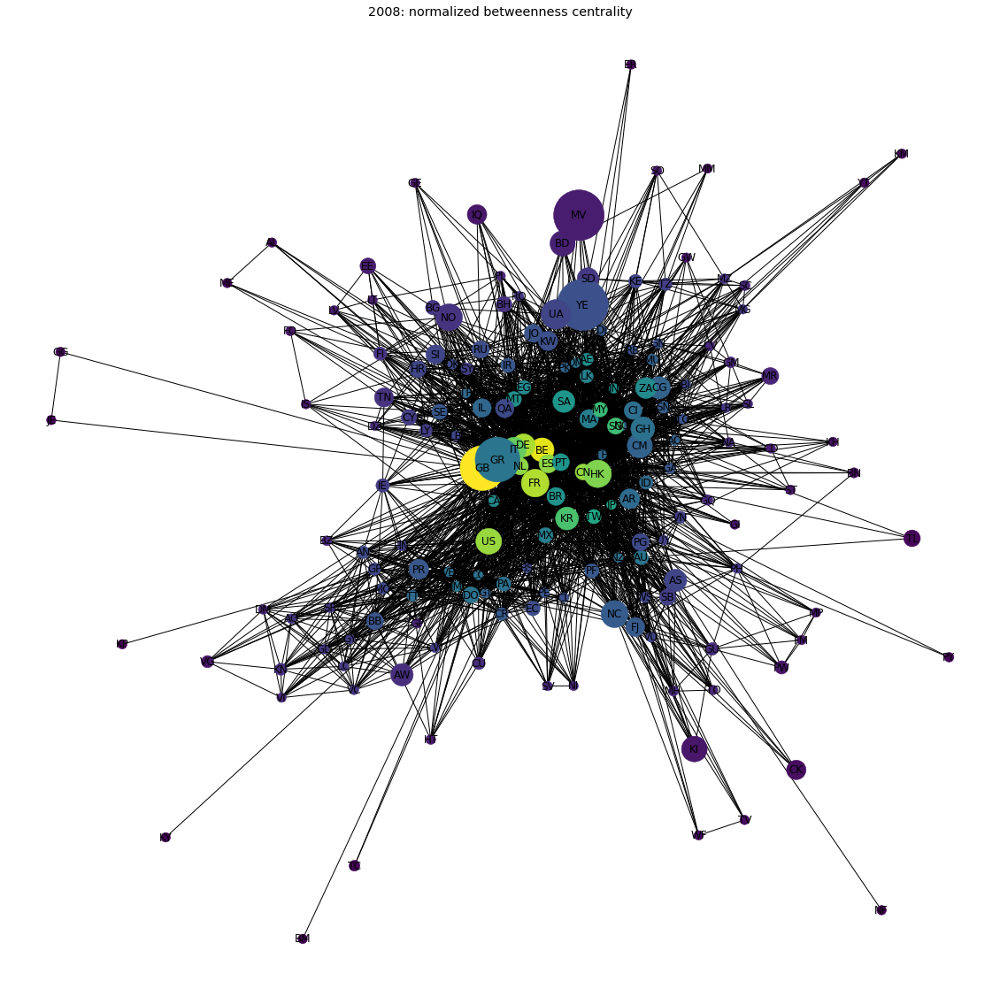

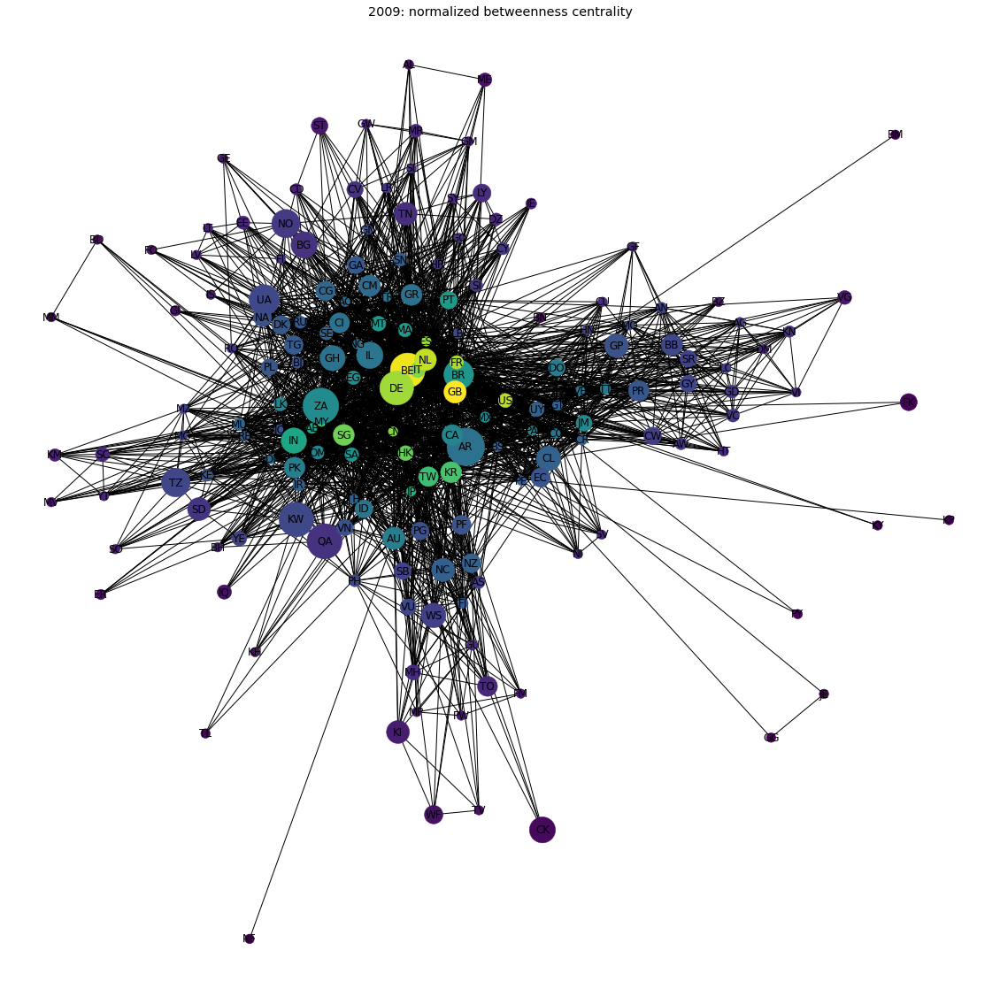

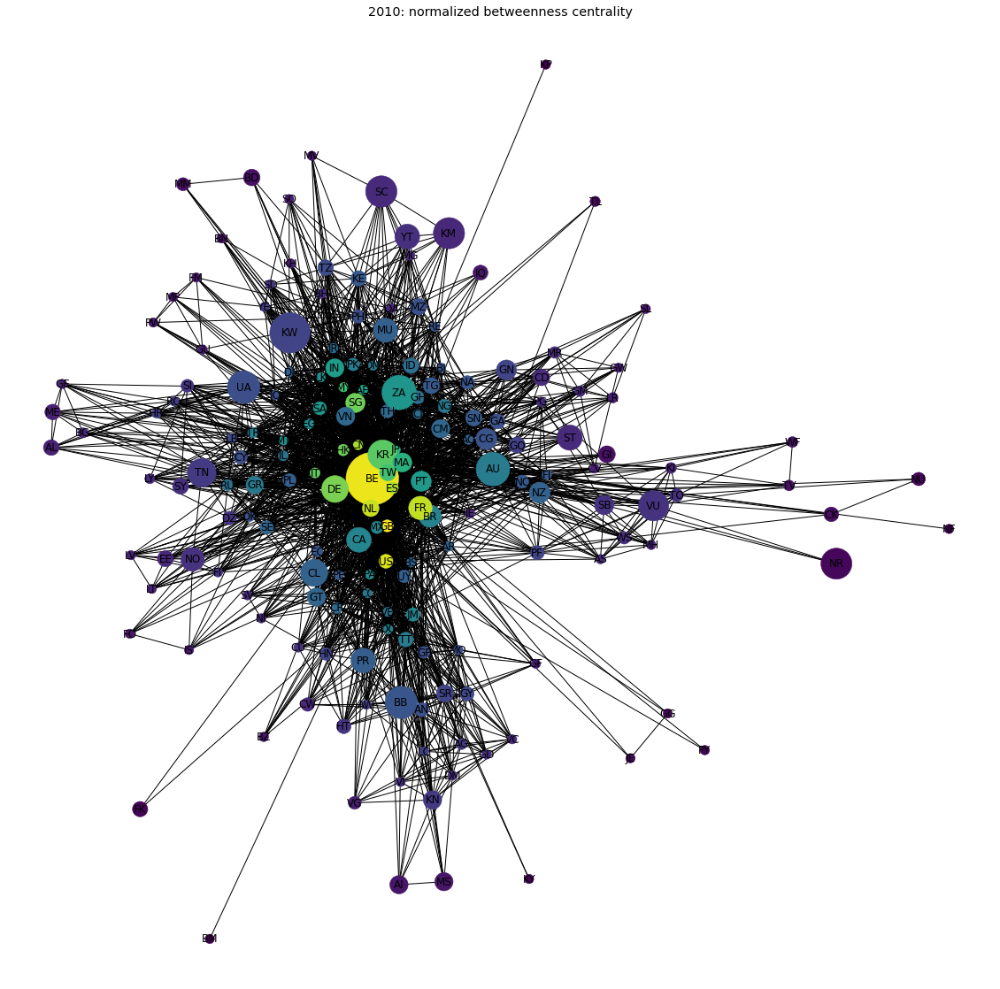

...

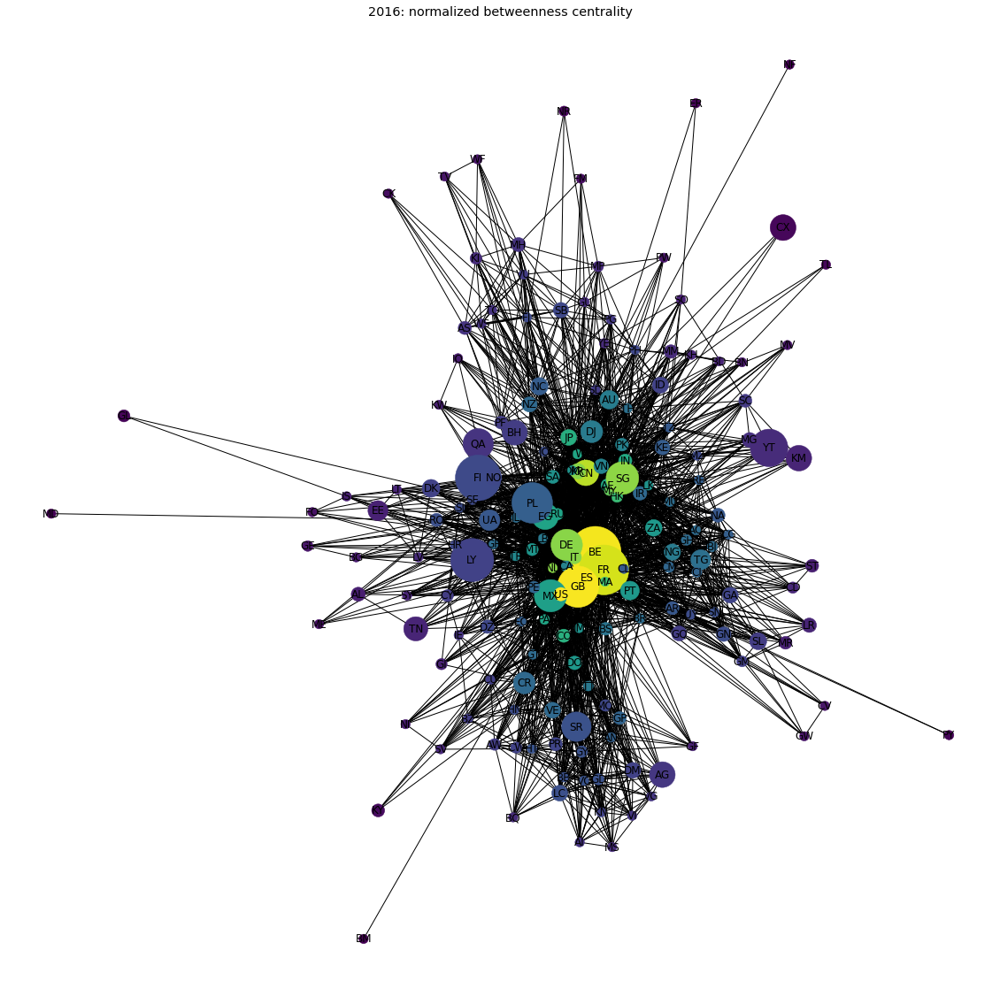

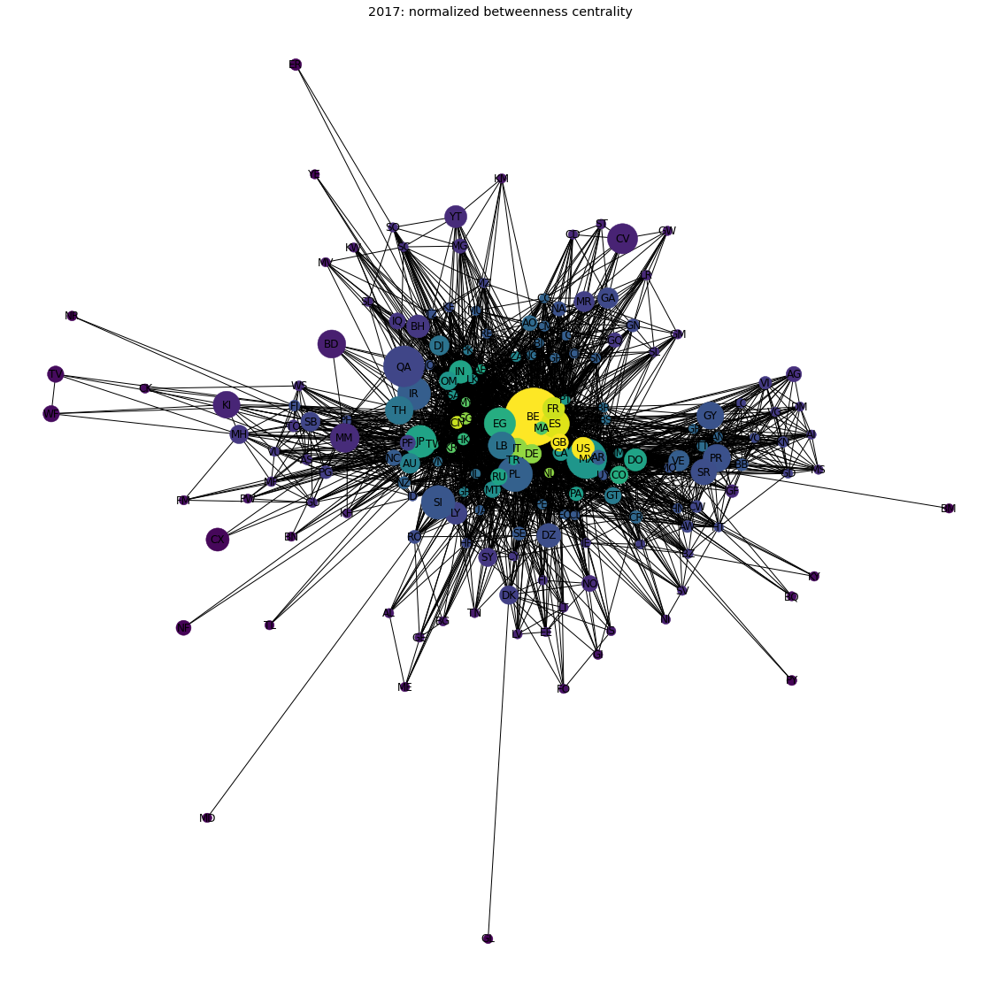

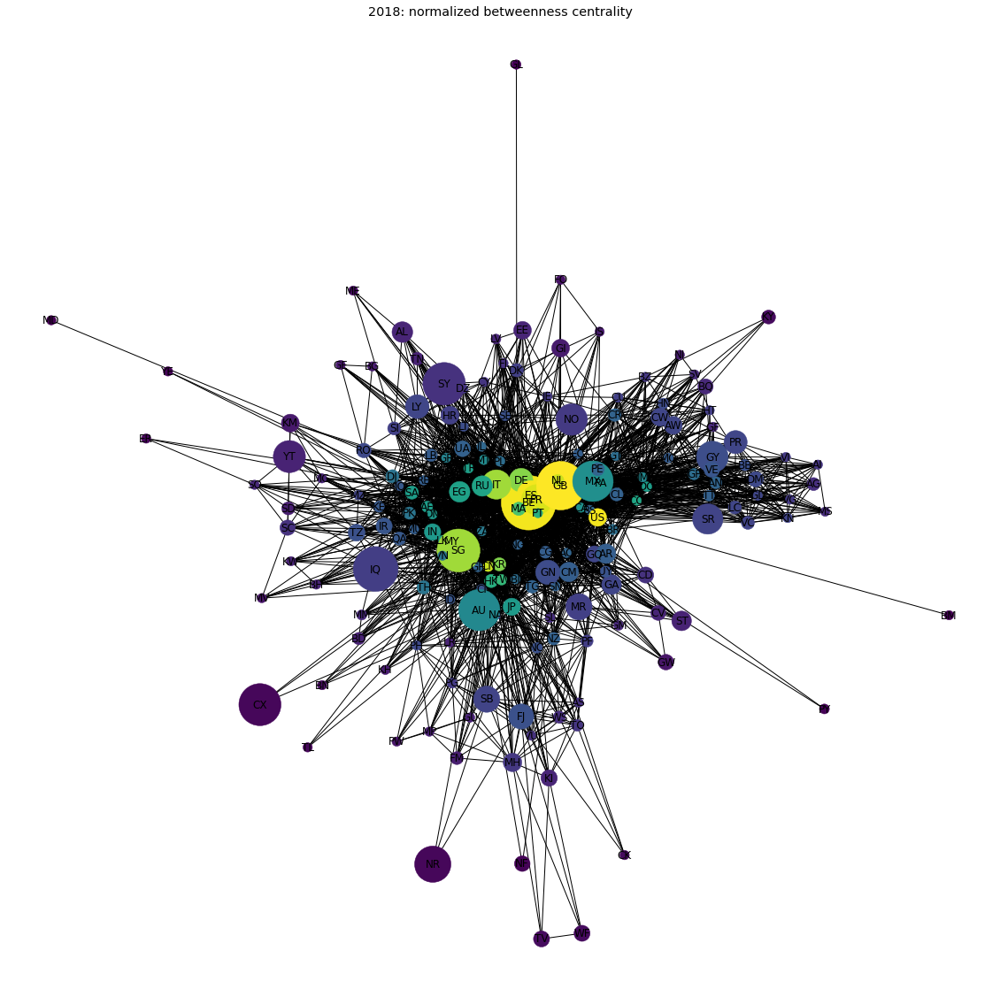

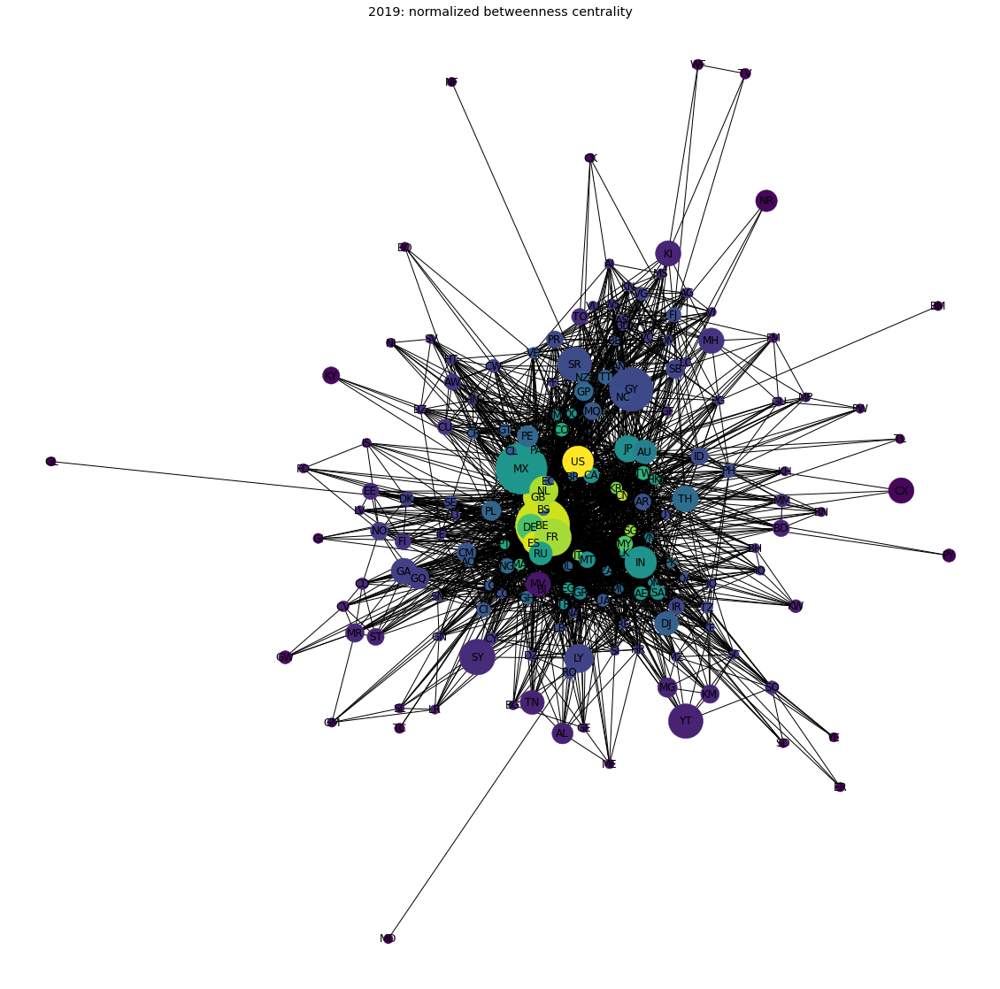

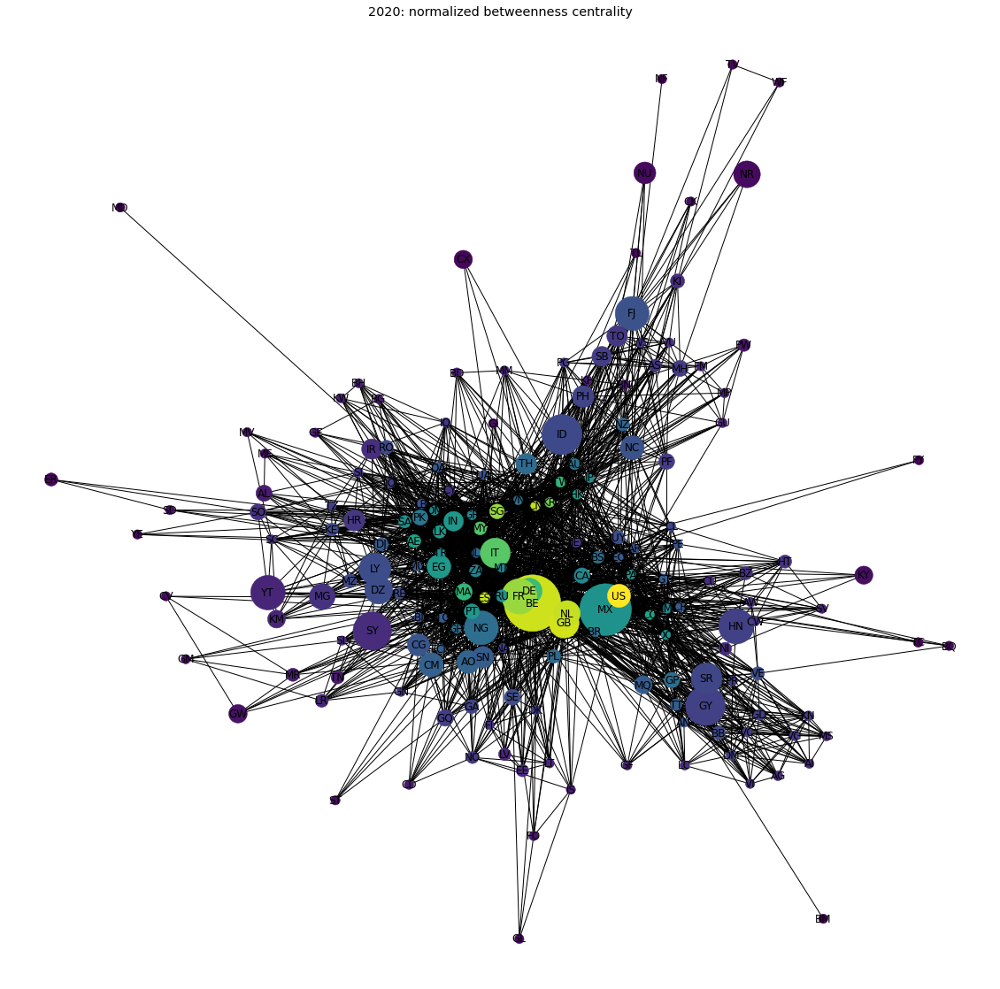

In [5]:
import glob
import networkx as nx
files = glob.glob("C:\\Users\\dauly\\Desktop\\mdst\\pickled\\*.gpickle")
for f in files:
    naming = f.split("\\")[-1]
    years = naming.split(".")[0][-4:]
    G = nx.read_gpickle(f)
    attr_dict = nx.get_node_attributes(G,'weight')
    pos = nx.spring_layout(G)
    betCent = nx.betweenness_centrality(G, weight='weight_sum',normalized=True, endpoints=True)
    node_color = [20000.0 * G.degree(v) for v in G]
    node_size =  [v * 10000 for v in betCent.values()]
    fig = plt.figure(figsize=(20,20))
    nx.draw_networkx(G, pos=pos, with_labels=True,
                 node_color=node_color,
                 node_size=node_size )
    plt.title("{}: normalized betweenness centrality".format(years))
    plt.axis('off');
    fig.savefig("y{}_betw_centr.png".format(years))
    print(years, sorted(betCent, key=betCent.get, reverse=True)[:5])

In [214]:
sorted(betCent, key=betCent.get, reverse=True)[:5]

['US', 'GB', 'CN', 'BE', 'ES']

2006 :  ['GB', 'BE', 'ES', 'FR', 'DE']
2007 :  ['BE', 'GB', 'FR', 'ES', 'DE']
2008 :  ['GB', 'BE', 'DE', 'CN', 'FR']
2009 :  ['BE', 'GB', 'NL', 'FR', 'DE']
2010 :  ['BE', 'GB', 'CN', 'NL', 'FR']
2011 :  ['BE', 'GB', 'CN', 'ES', 'NL']
2012 :  ['BE', 'US', 'ES', 'FR', 'GB']
2013 :  ['US', 'BE', 'ES', 'FR', 'GB']
2014 :  ['US', 'BE', 'ES', 'FR', 'GB']
2015 :  ['BE', 'ES', 'GB', 'FR', 'US']
2016 :  ['BE', 'ES', 'GB', 'FR', 'US']
2017 :  ['BE', 'GB', 'ES', 'FR', 'CN']
2018 :  ['BE', 'ES', 'GB', 'FR', 'NL']
2019 :  ['BE', 'ES', 'GB', 'US', 'CN']
2020 :  ['BE', 'US', 'GB', 'NL', 'CN']


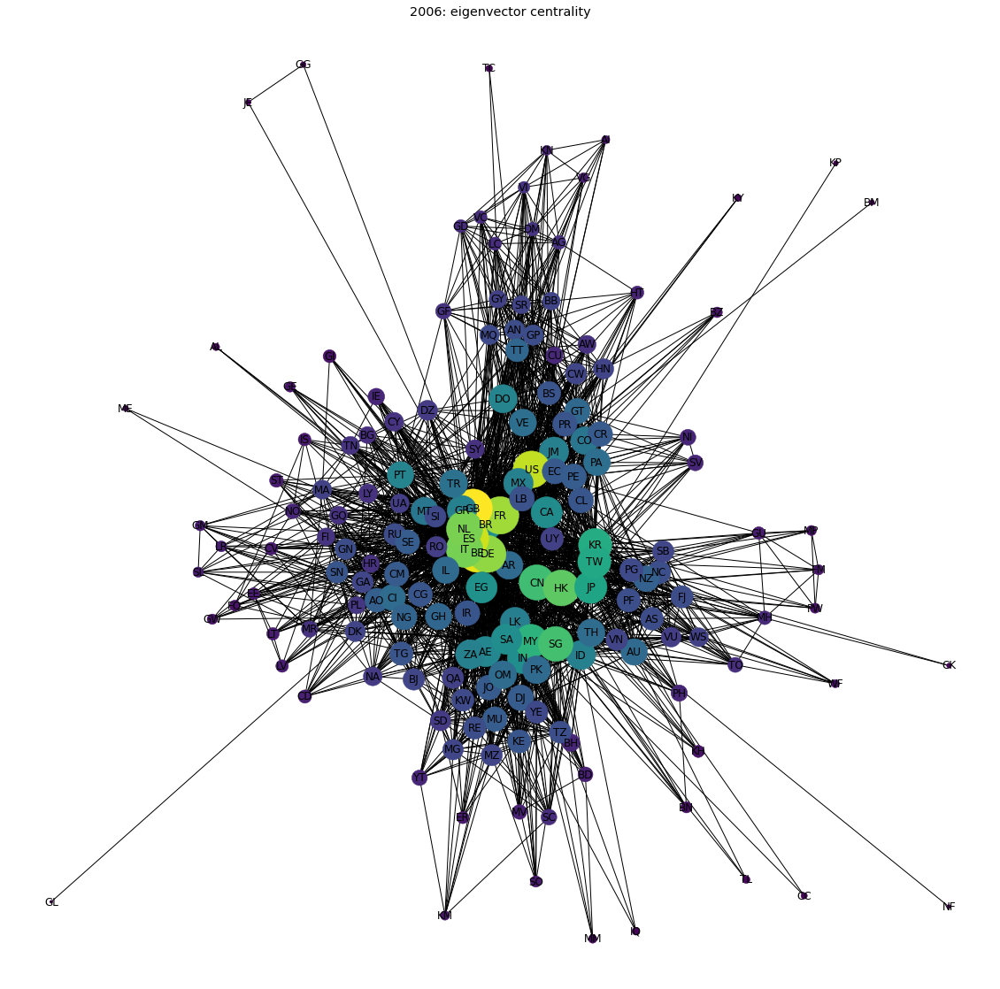

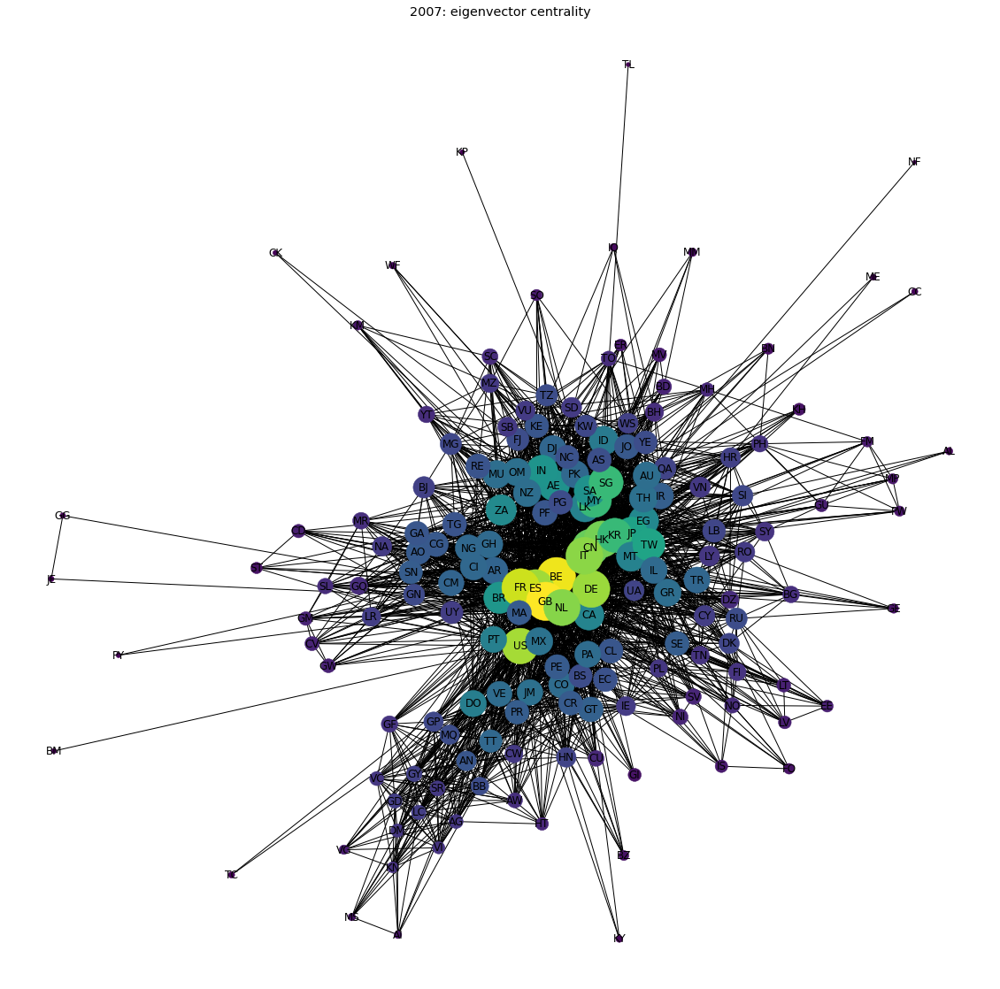

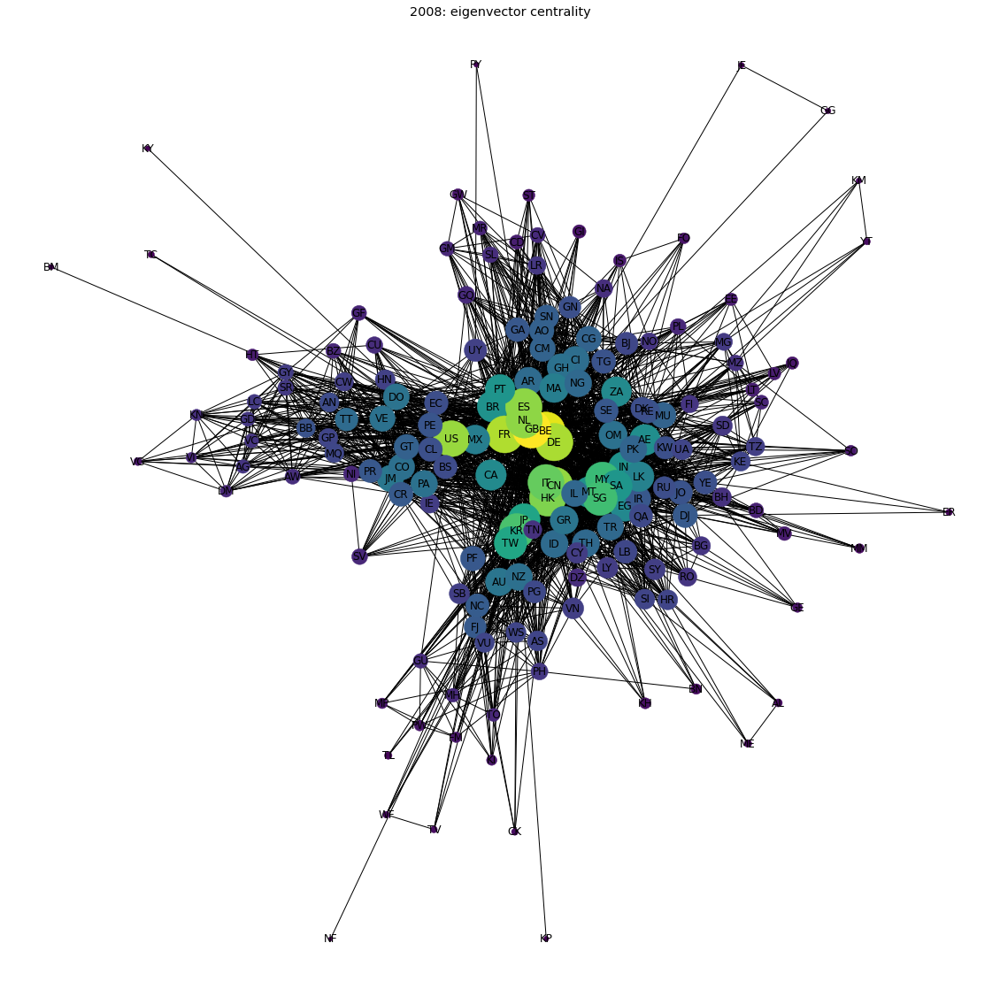

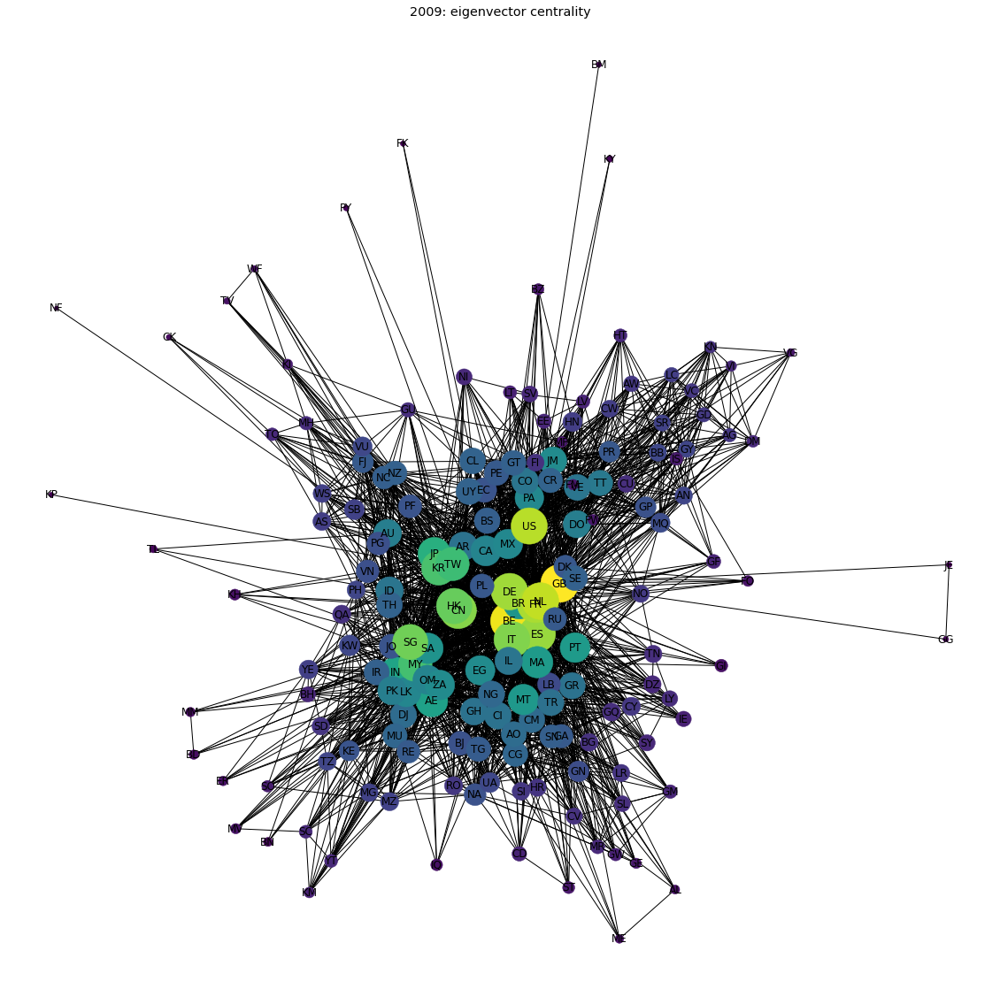

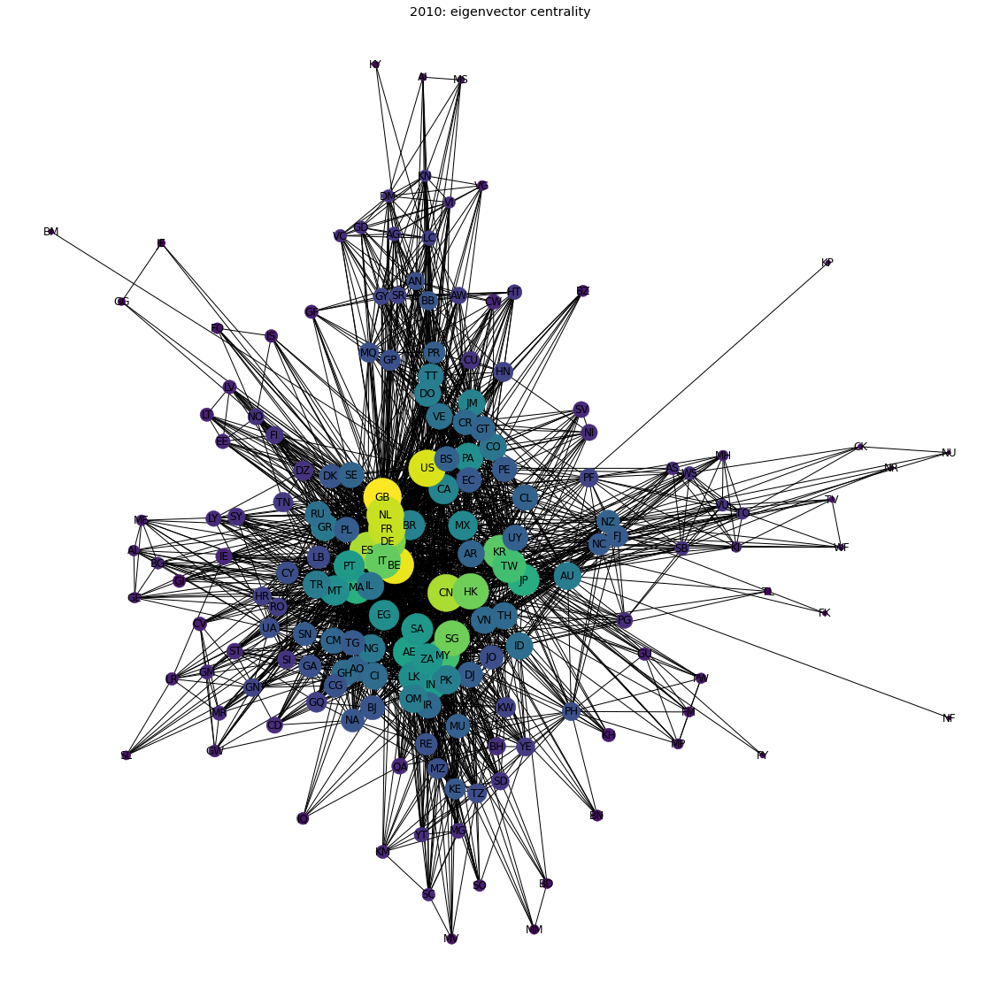

...

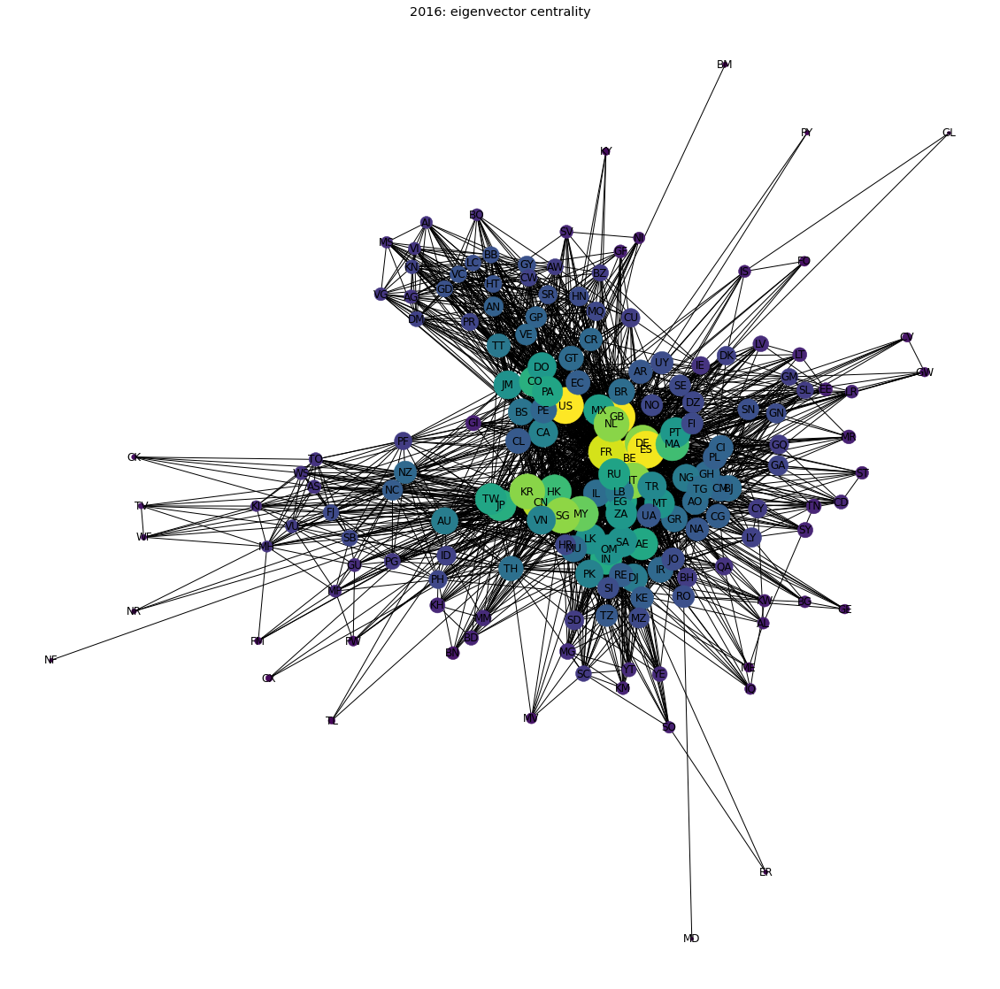

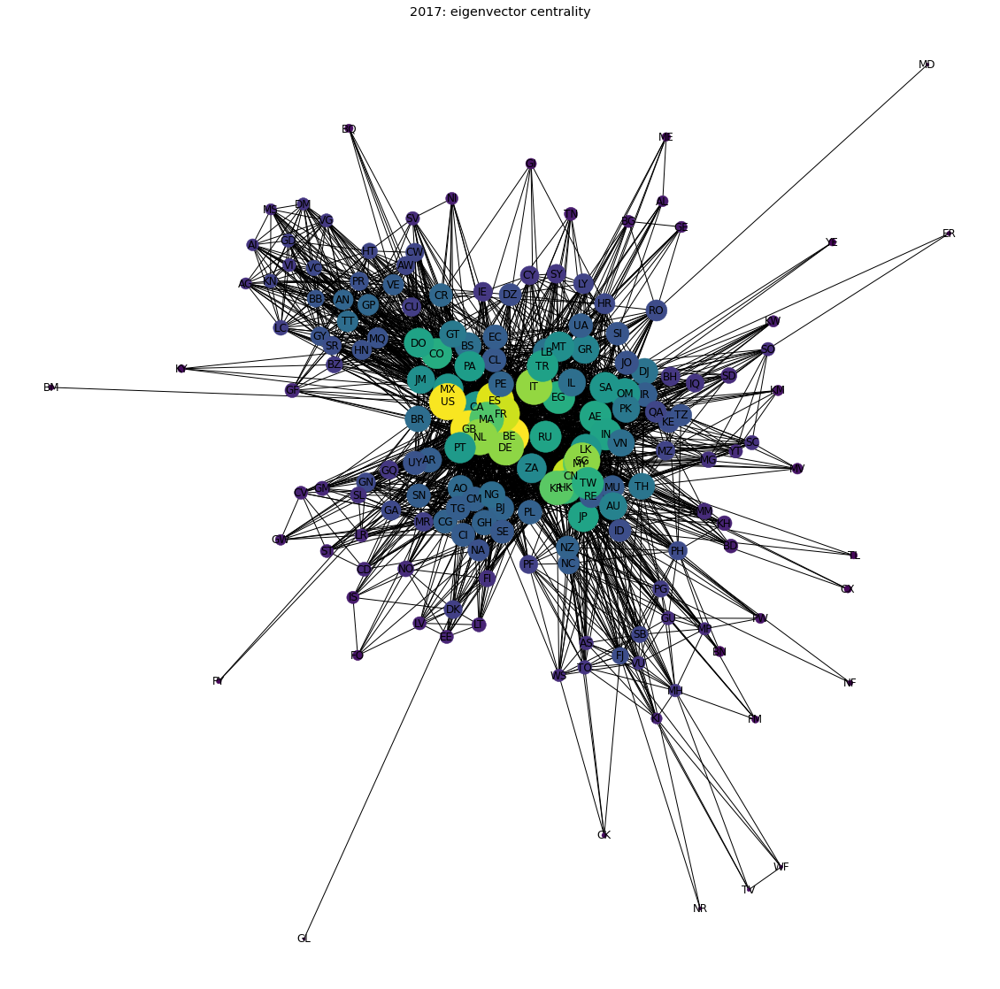

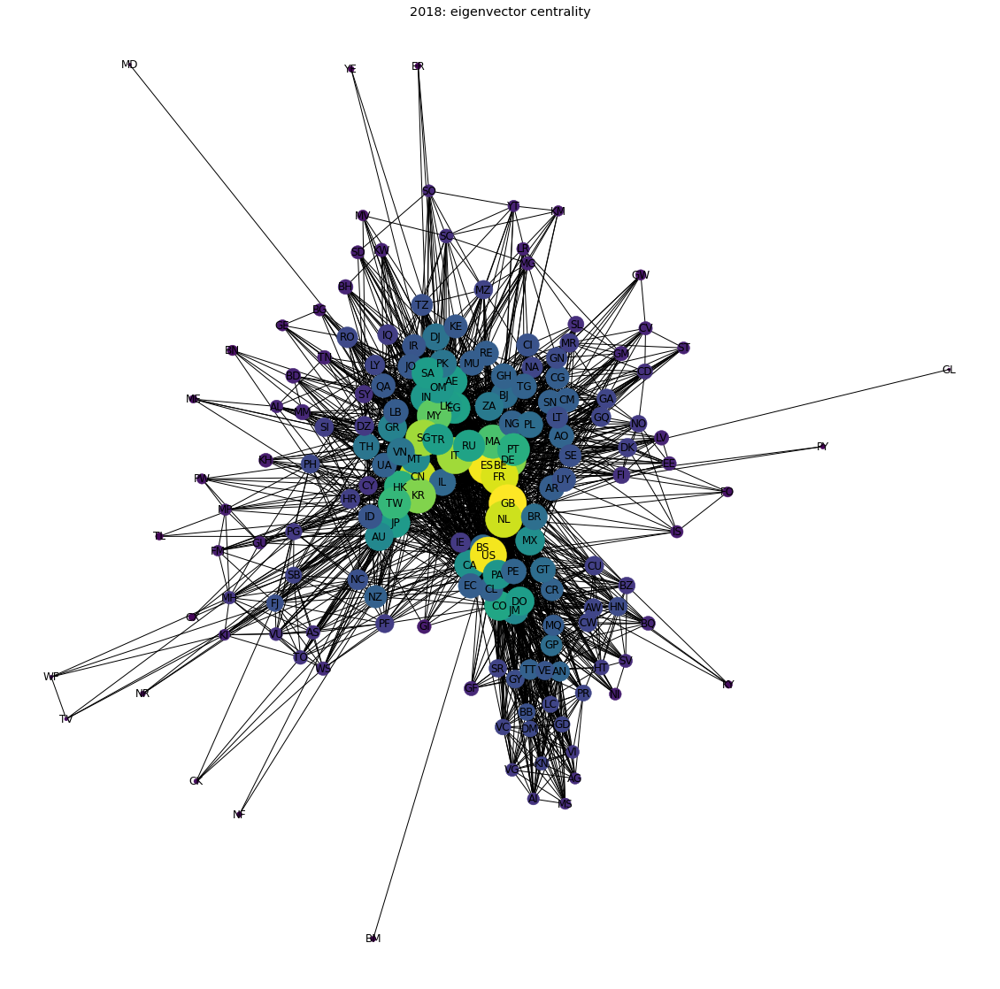

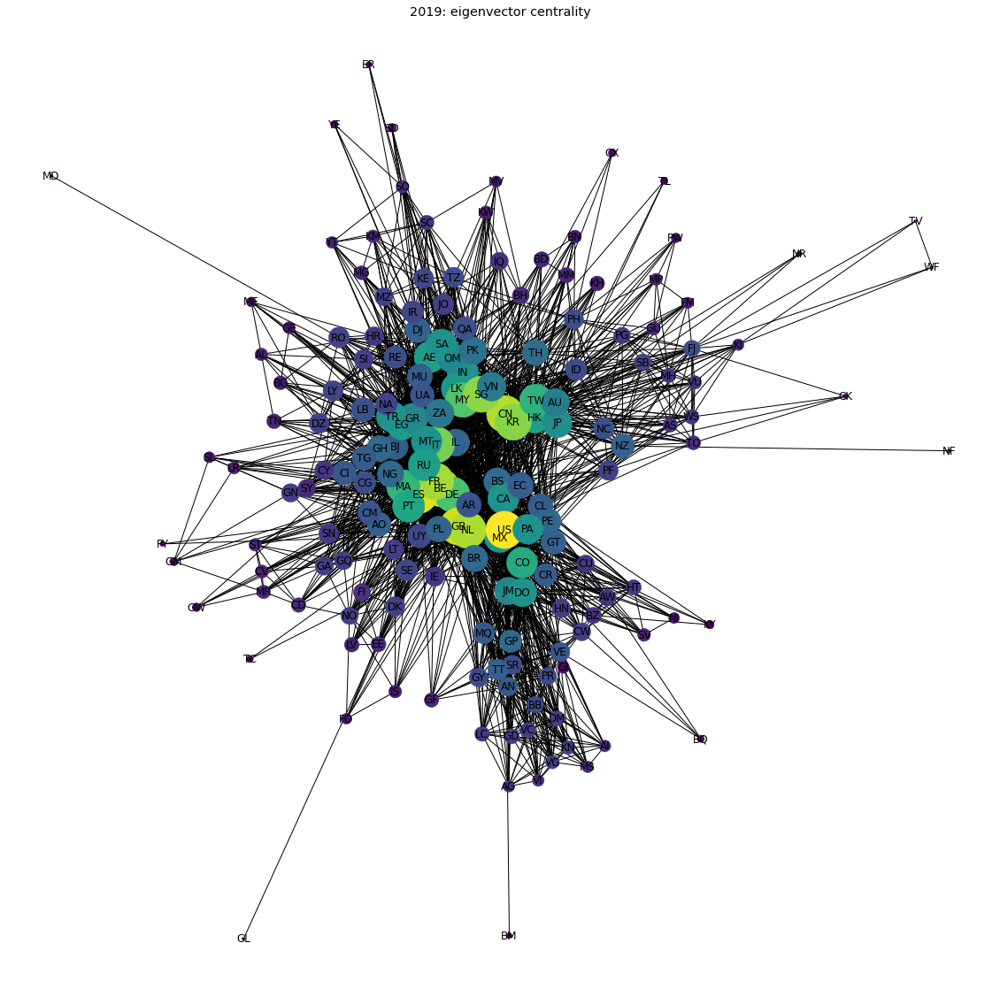

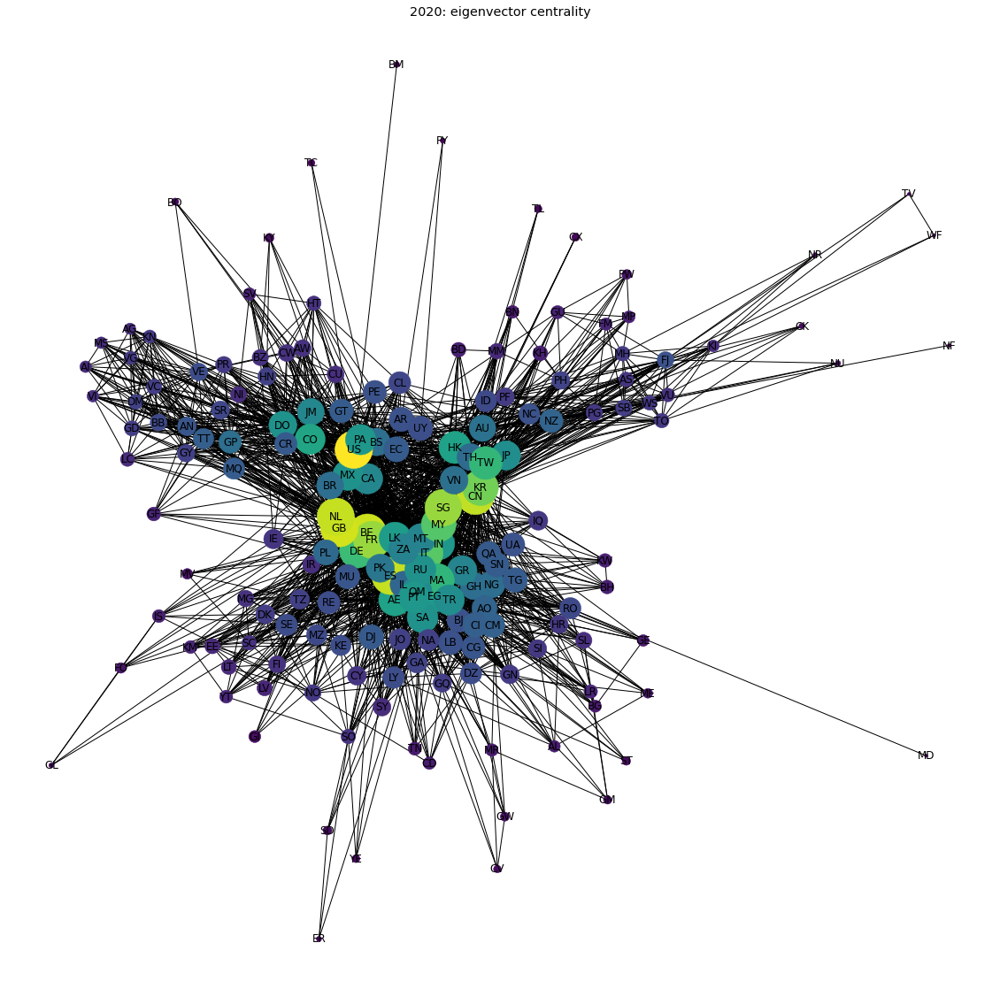

In [6]:
import glob
files = glob.glob("C:\\Users\\dauly\\Desktop\\mdst\\pickled\\*.gpickle")
for f in files:
    naming = f.split("\\")[-1]
    years = naming.split(".")[0][-4:]
    G = nx.read_gpickle(f)
    pos = nx.spring_layout(G)
    ecent = nx.eigenvector_centrality(G)
    node_color = [20000.0 * G.degree(v) for v in G]
    node_size =  [v * 10000 for v in ecent.values()]
    fig = plt.figure(figsize=(20,20))
    nx.draw_networkx(G, pos=pos, with_labels=True,
                 node_color=node_color,
                 node_size=node_size )
    plt.title("{}: eigenvector centrality".format(years))
    plt.axis('off');
    fig.savefig("y{}_ecent_centr.png".format(years))
    print(years,": ", sorted(ecent, key=ecent.get, reverse=True)[:5])

In [216]:
sorted(ecent, key=ecent.get, reverse=True)[:5]

['BE', 'ES', 'GB', 'FR', 'NL']

2006
2006 ['GB', 'BE', 'ES', 'US', 'FR']
2007
2007 ['GB', 'BE', 'FR', 'US', 'ES']
2008
2008 ['GB', 'BE', 'FR', 'DE', 'US']
2009
2009 ['GB', 'BE', 'NL', 'US', 'FR']
2010
2010 ['GB', 'BE', 'US', 'NL', 'FR']
2011
2011 ['GB', 'BE', 'US', 'FR', 'NL']
2012
2012 ['US', 'BE', 'GB', 'FR', 'ES']
2013
2013 ['US', 'GB', 'FR', 'BE', 'ES']
2014
2014 ['US', 'GB', 'FR', 'BE', 'ES']
2015
2015 ['BE', 'US', 'GB', 'ES', 'FR']
2016
2016 ['US', 'BE', 'GB', 'ES', 'FR']
2017
2017 ['US', 'BE', 'GB', 'CN', 'ES']
2018
2018 ['GB', 'US', 'BE', 'ES', 'CN']
2019
2019 ['US', 'ES', 'BE', 'GB', 'CN']
2020
2020 ['US', 'CN', 'GB', 'BE', 'NL']


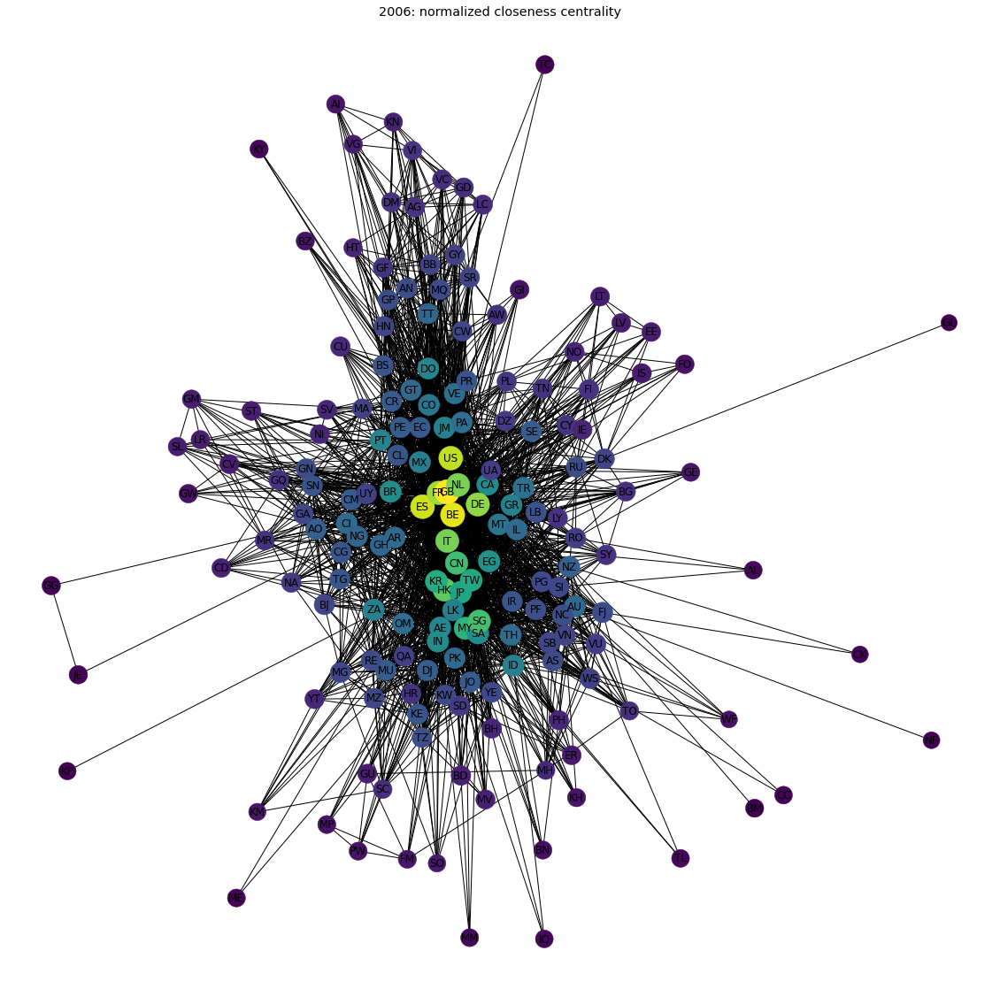

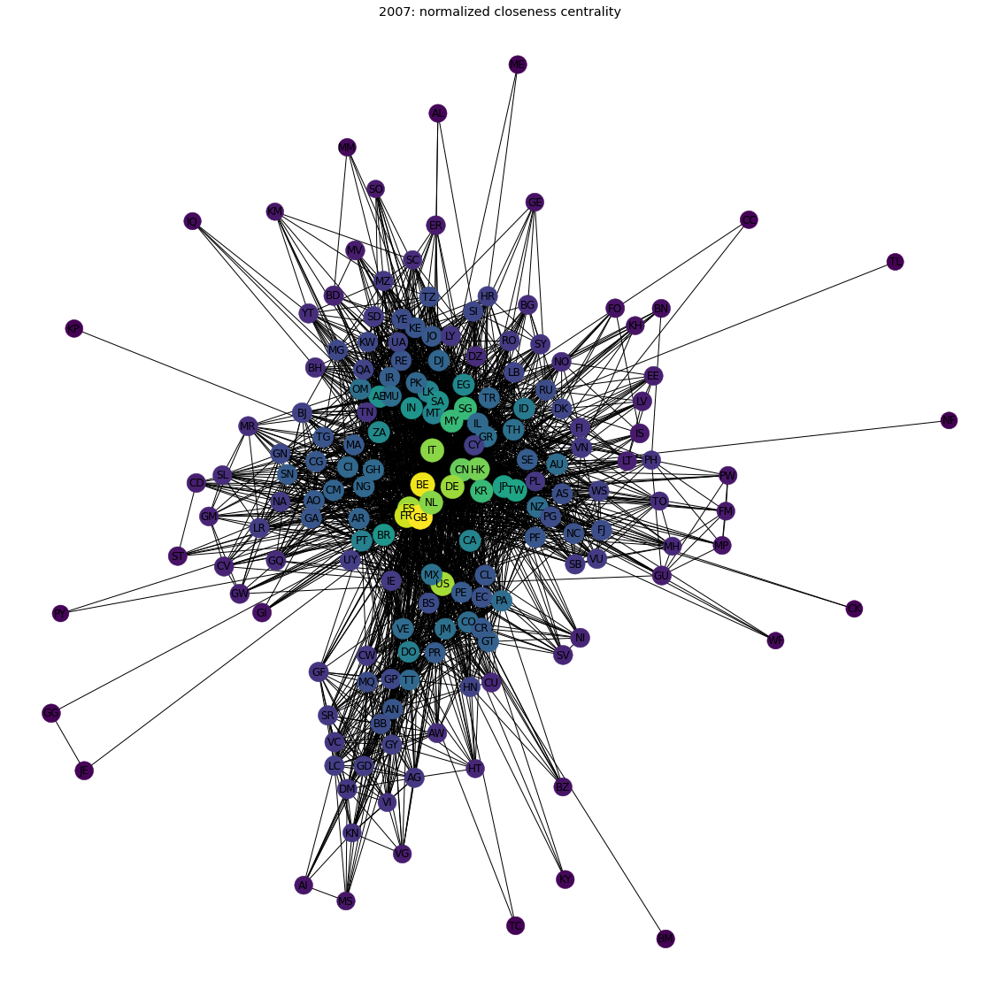

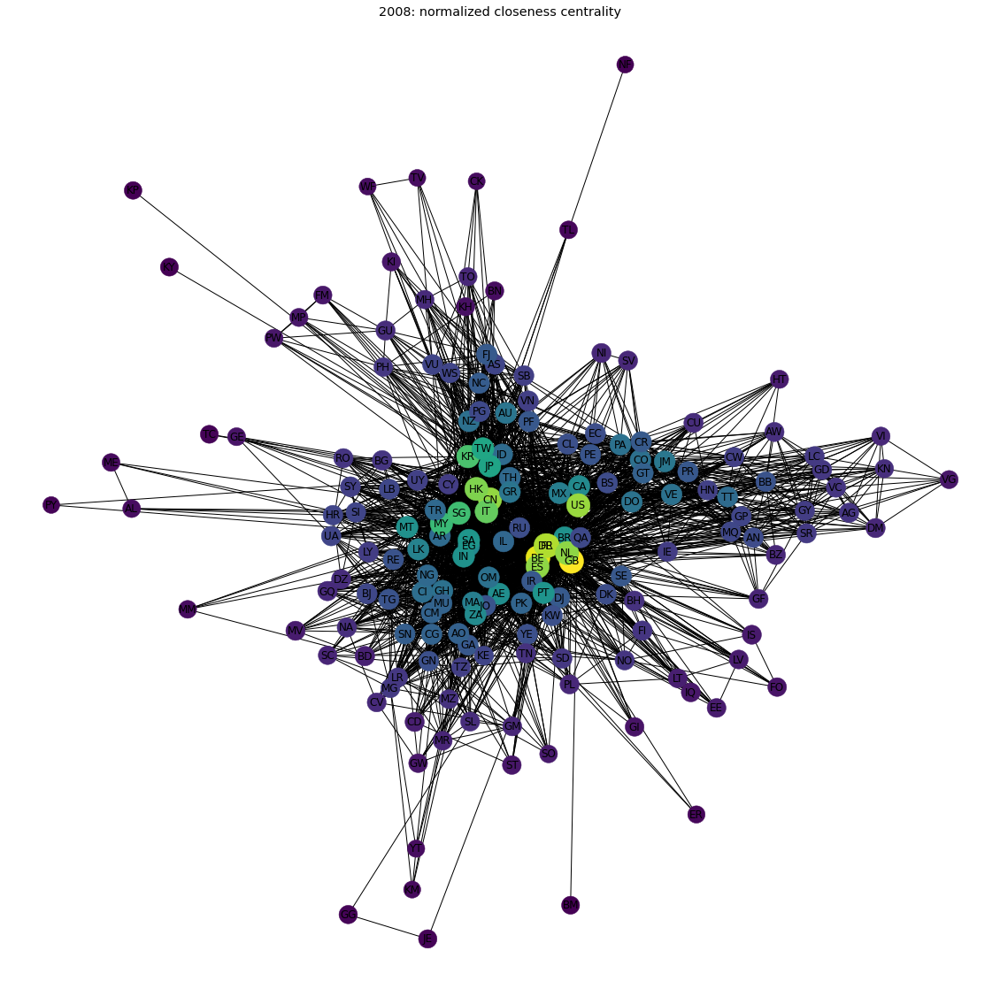

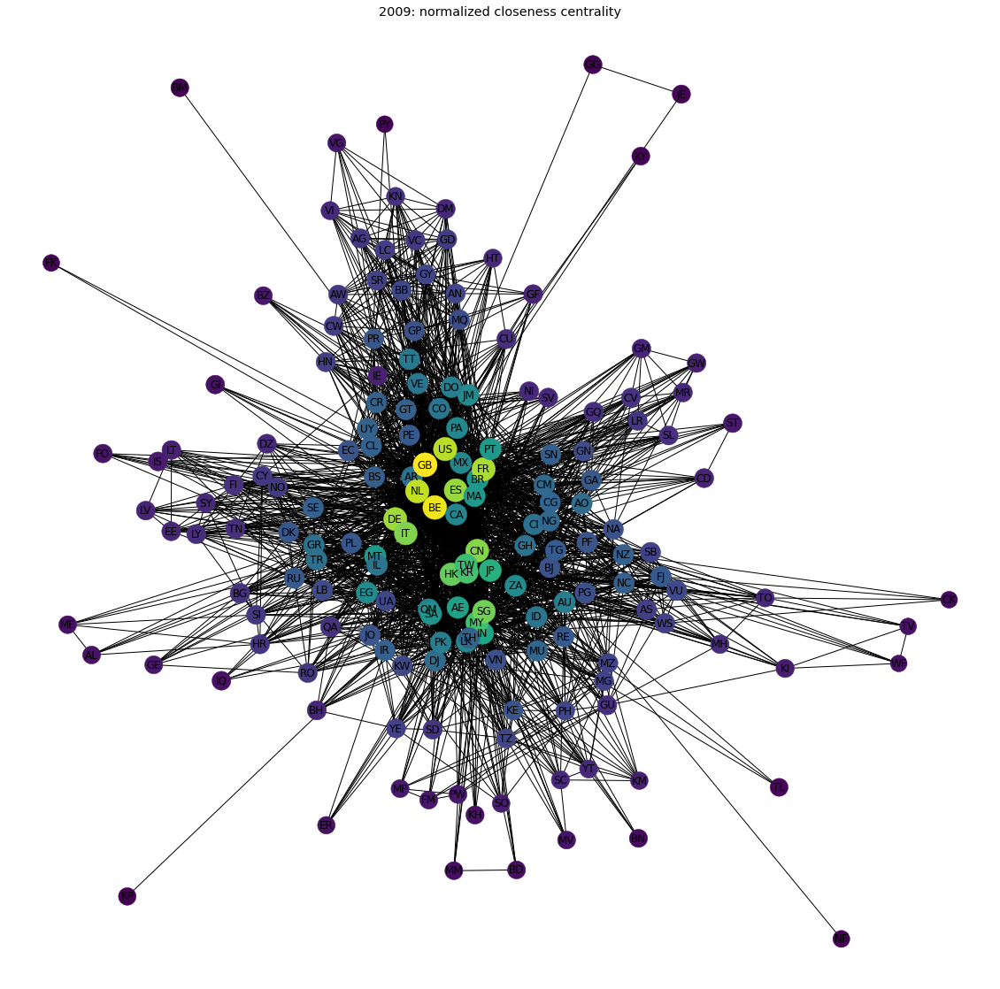

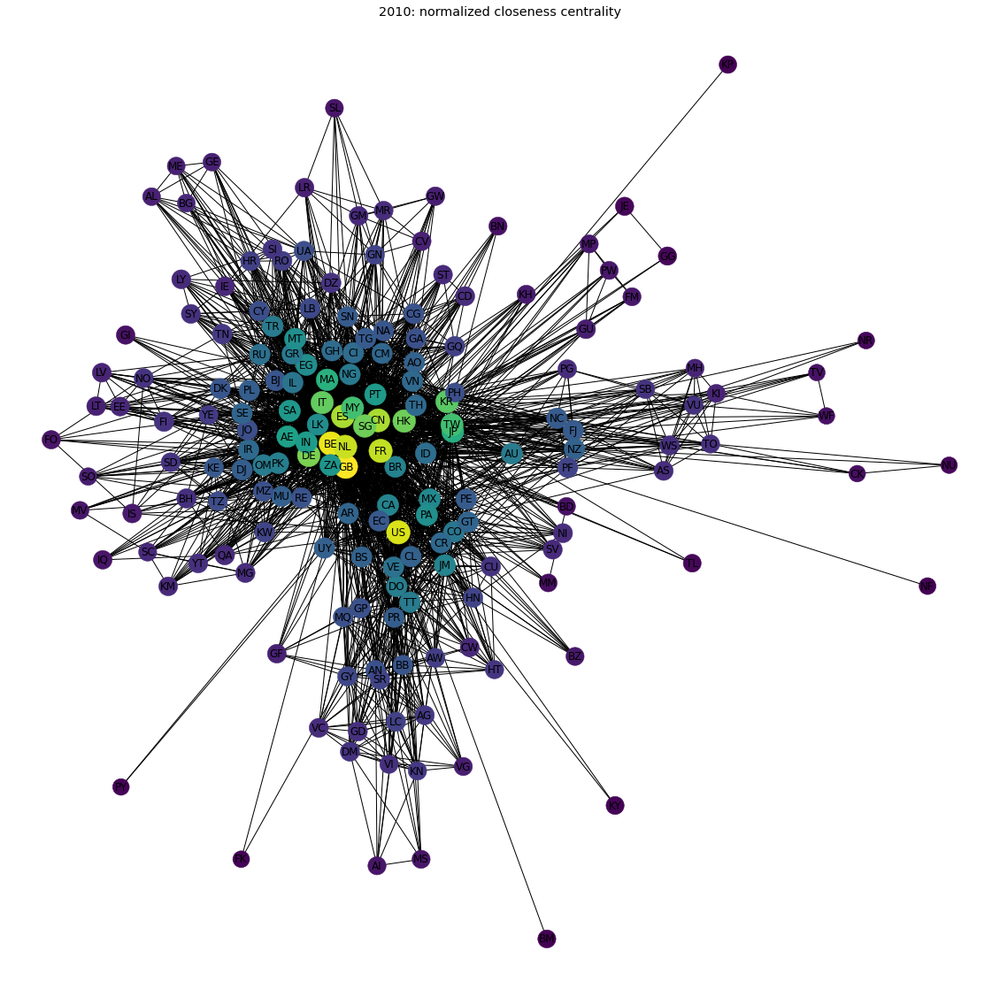

...

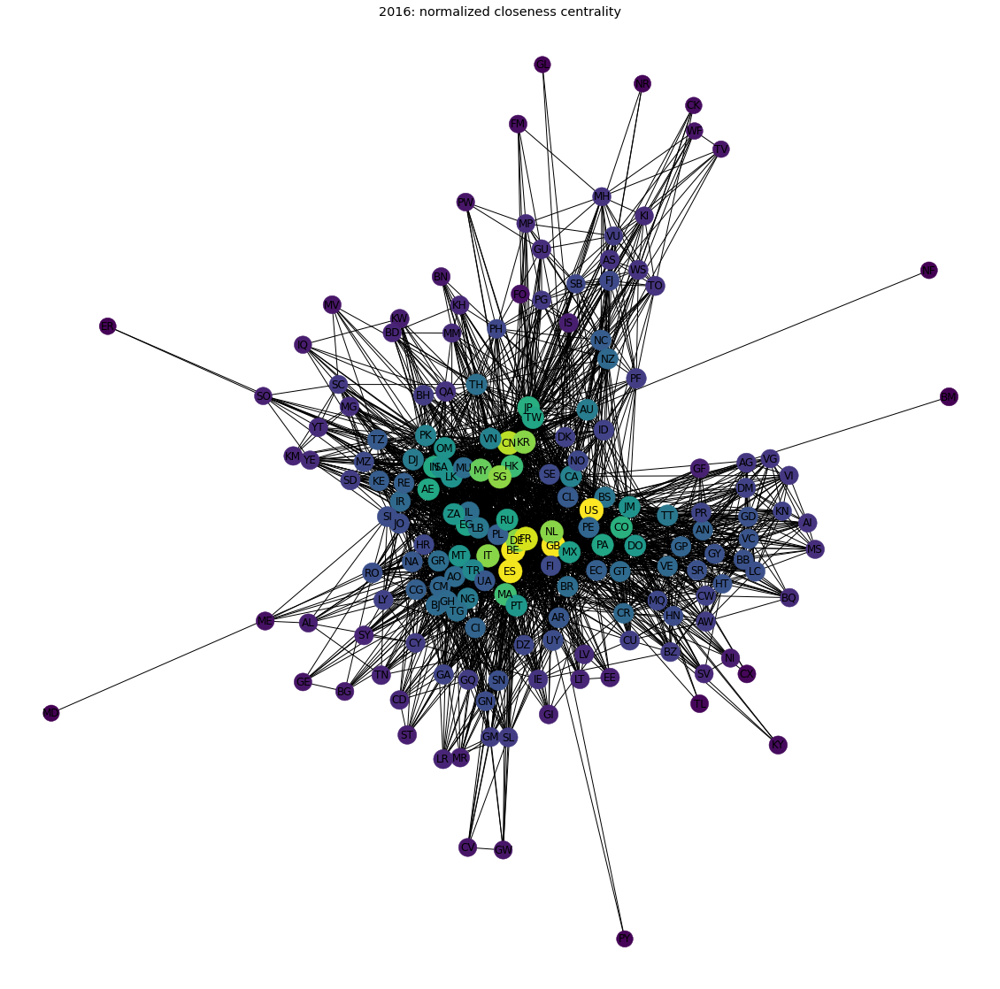

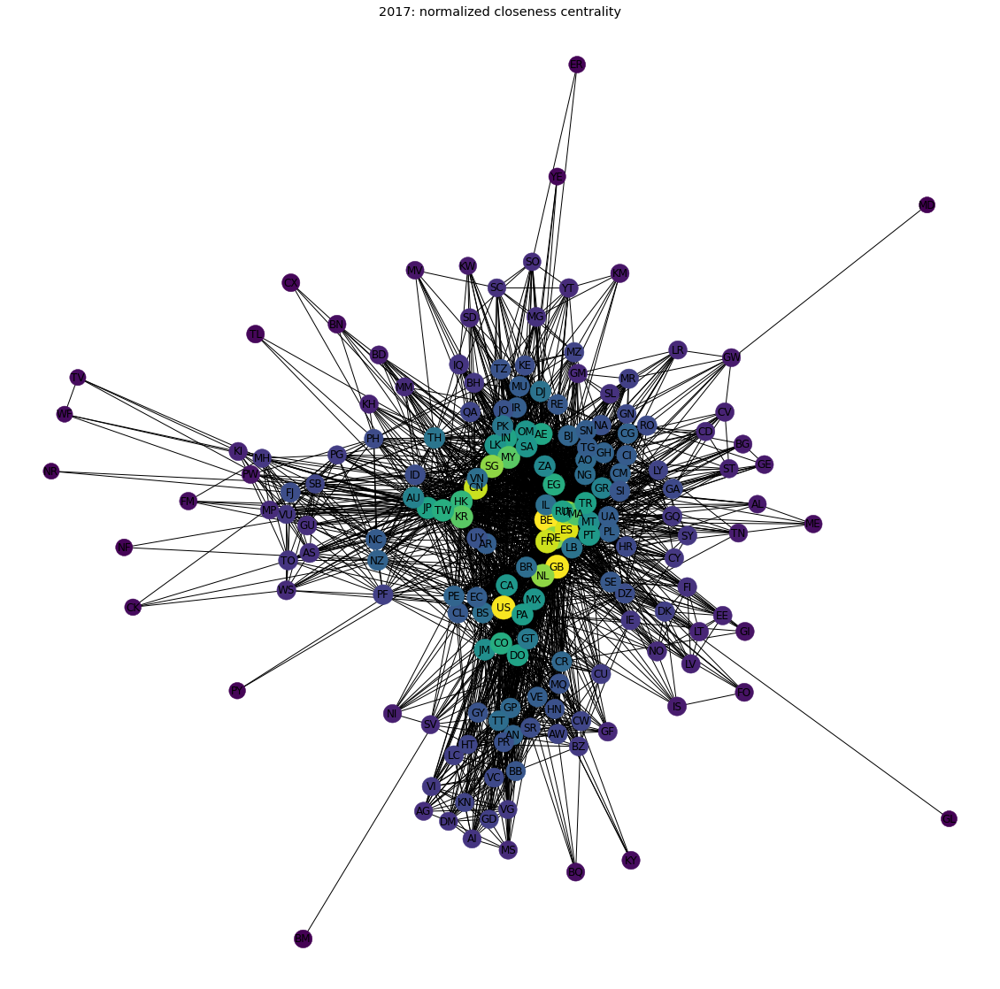

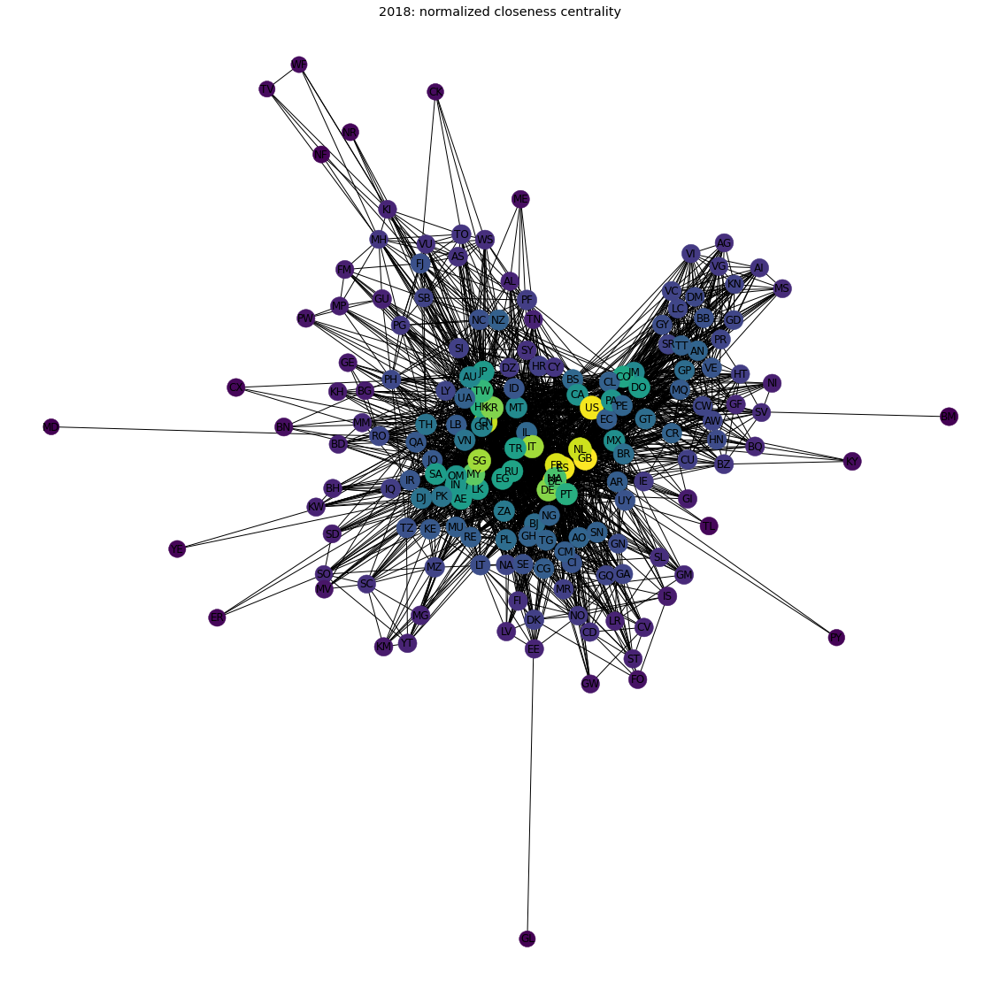

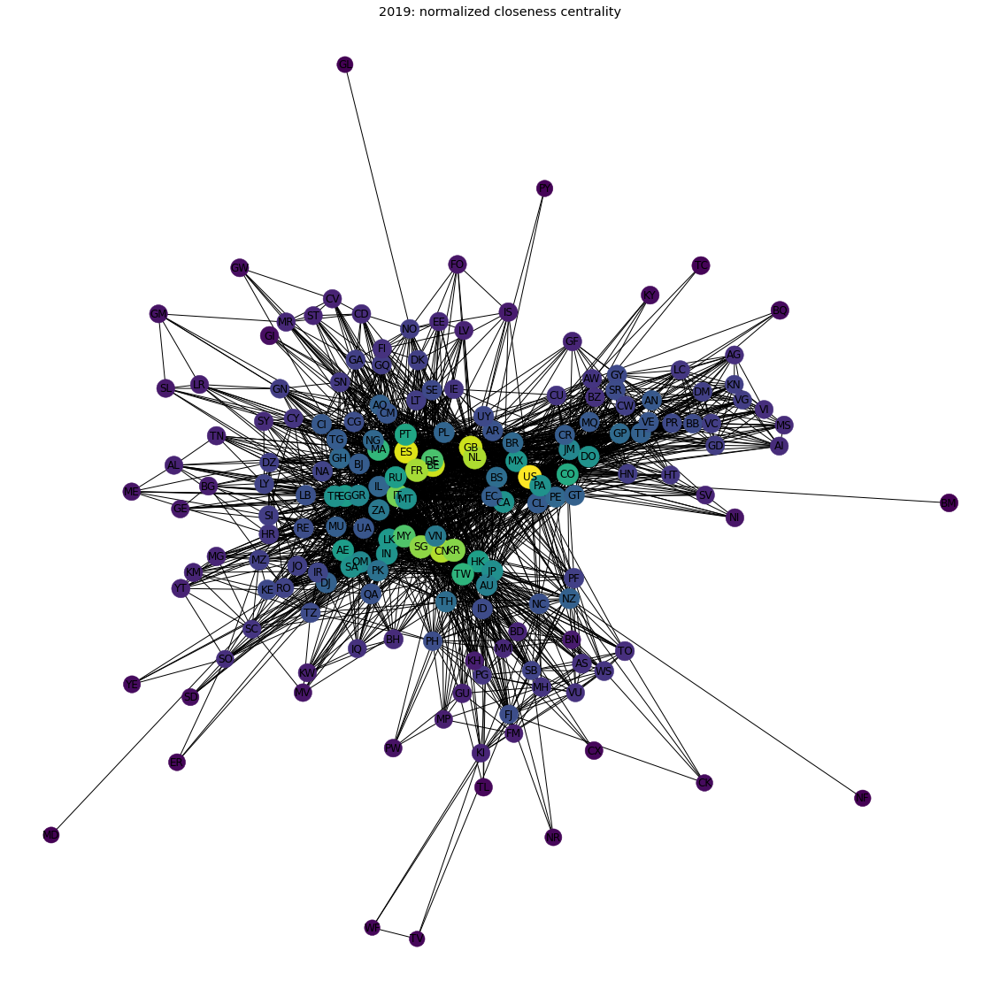

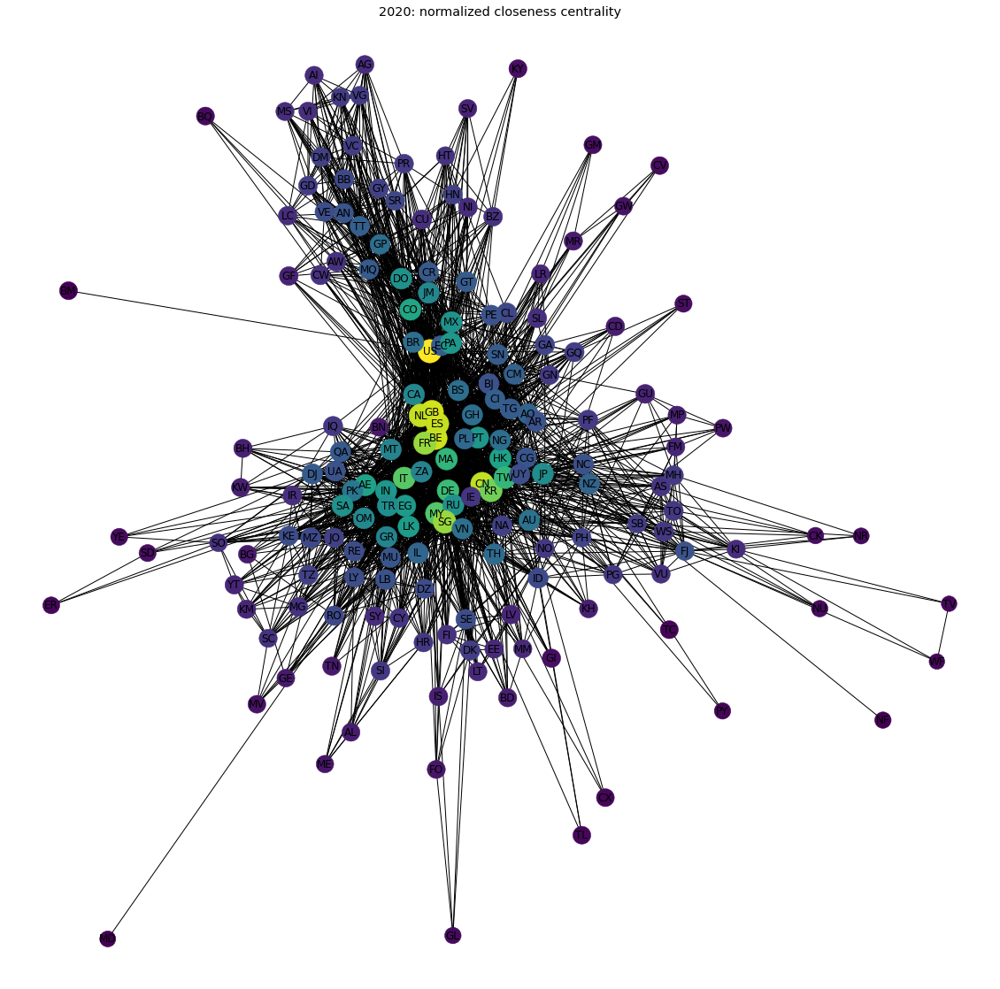

In [7]:
import glob
files = glob.glob("C:\\Users\\dauly\\Desktop\\mdst\\pickled\\*.gpickle")
for f in files:
    naming = f.split("\\")[-1]
    years = naming.split(".")[0][-4:]
    G = nx.read_gpickle(f)
    pos = nx.spring_layout(G)
    ccent = nx.closeness_centrality(G)
    node_color = [20000.0 * G.degree(v) for v in G]
    node_size =  [v * 1000 for v in ccent.values()]
    fig = plt.figure(figsize=(20,20))
    nx.draw_networkx(G, pos=pos, with_labels=True,
                 node_color=node_color,
                 node_size=node_size )
    plt.title("{}: normalized closeness centrality".format(years))
    plt.axis('off');
    fig.savefig("y{}_close_centr.png".format(years))
    print(years, sorted(ccent, key=ccent.get, reverse=True)[:5])

In [219]:
sorted(ccent, key=ccent.get, reverse=True)[:5]

['GB', 'US', 'BE', 'ES', 'CN']